# Overview

This notebook is authored by:

*Coen Petto*

*Ethan Fantl*

*Brendan Scheidt*

## Goal

The goal for this project was to investigate Convolutional Neural Networks and their accuracy when classfying emotions given a facial image. In order to do this and better understand what the accuracy we obtained means in the context of other models, we decided to use the SVM model as a baseline. In order to not "straw man" a model in order to inflate our own accuracy and gain a better understanding of how to use models, we did an extensive investigaiton into multiple ways to use each model. We also had a goal of learning more about neural networks as we explored different architectures and contemporary training techniques.

## Why Should We Use Machine Learning?

This may seem like a trivial problem, and that you may think human emotions are obvious.

Here I have prepared a Google Form that is a little quiz on the emotions present in our dataset. [(take the quiz here)](https://forms.gle/WZZkHC9Pn8Bkn23y7).

So far the rolling average on this quiz is less than 50%. If you feel like you disagree with some of the correct answers you should begin to question who created this dataset and how the labels were created.

Towards the bottom of this notebook when we dive deep into what our models misclassify, some of your struggles/human struggles during the quiz may reoccur in the computer's behaviour. This may serve as a stark reminder that your model is only as good as your data!


## Data Description

Our data consists of roughly 25,000 96x96 colored images of human faces. These images are classified by their expressed emotion. There are 8 classes including Anger, Contempt, Disgust, Fear, Happy, Neutral, Sad, and Surprise.

This data will help us answer an interesting question. Is it possible for a convolutional neural network to detect the very small tells of a human's emotion?

A couple of factors that will effect our results stem from our data being a still image. Often in real life humans are given the beginning and ends of an emotion, along with our other senses besides sight. Isolating these images to a still frame is making this a very focused task.

Additionally, some emotions are expressed very similarily. For example, picture someone who is scared. Now picture someone is surprised. We imagine these faces both have their eyebrows raised, and mouths open. Not to foreshadow too much, but it is very likely that a machine learning algorithm will struggle on these classes just like humans would.

## Methods

We decided to test the ability for a convolutional neural network with low, medium, and large complexity to perform on human emotion classification. We also compared them to a few baseline SVM classifiers to compare accuracies across all models.

*SVM baselines*:
*   SVM with no preprocessing before fitting model
*   SVM with feature extraction from a CNN
*   SVM with feature extraction using a HOG filter
*   SVM with facial landmark detection through DLIB

*Convolutional Models*:
* Transfer learning ResNet50 model
* simplistic CNN-10 model
* medium complexity ConvNet model

The first step is to clean up our dataset by balancing the class count of our data as well as normalizing the pixel values.

Then, the hyperparameter search for SVM will be using grid search cross validation to find the best kernel and margin penalization parameters. For the convolutional neural networks, we will be using the keras hyperparameter tuner to find the best hyperparameters for the model's architecture. This includes regularization amount, dropout layer intensity, convolutional filter size, density of neuron units, and the learning rate.


## Responsibilities

***Coen Petto:***

> Coen was responsible for cleaning/preparing the image data as well as providing abstract descriptions of each section. In my preprocessing section you will see visualizations of the data, and the loading of the images from a folder. The large descriptions will be present towards the beginning and end of each section.

***Ethan Fantl:***

> Ethan was responsible for the research on possible feature extraction methods as well as the implementation and testing of those methods on SVM's. He also was responsible for writing the analysis of those methods in our Results/Intepretation section.

***Brendan Scheidt:***

>Brendan was responsible for researching, training, and fine tuning the Convolutional Neural Network models. He wrote the corresponsing sections to the CNN model architecture.

***Everyone:***

> As a group, we each wrote sections of the Overview, Results/Interpretation, and Conclusion section collaboratively.


# Importing/Cleaning Up Data

## Importing Images

We start by importing the essential libraries for the notebook.

In [1]:
import numpy as np #  Essential for numerical computations and array operations
import matplotlib.pyplot as plt # Data visualization and plotting graphs.
import os # For interacting with the operating system, useful for file operations and directory handling.
import cv2 # OpenCV library for image processing tasks.

We also used a shared Google drive folder for saving and loading the dataset and our classification models.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Then, we import our images, normalize them, and load in the corresponding classification labels.

In [3]:
# Helper function to load in images as a NumPy array
def load_images_from_folder(folder, target_size=(96, 96)):
    images = []
    files = sorted(os.listdir(folder))  # Sort the list of files
    for filename in files:
        img_path = os.path.join(folder, filename)
        img = cv2.imread(img_path)
        if img is not None:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            resized_img = cv2.resize(img, target_size)  # Resize the image
            images.append(resized_img)
    return np.array(images)

In [ ]:
!cp "/content/drive/My Drive/CS345 Project/images.zip" "/content"
!unzip -qo "/content/images.zip" -d "/content"

Luckily, our dataset already had the training, validation, and test sets separated into different folders to import.

In [ ]:
train_images = load_images_from_folder('YOLO_format/train/images')

In [ ]:
test_images = load_images_from_folder('YOLO_format/test/images')

In [ ]:
validation_images = load_images_from_folder('YOLO_format/valid/images')

We are left with ~17,000 training images, ~2,700 validation set images, and ~5,400 test set images.

In [ ]:
print(train_images.shape)
print(test_images.shape)
print(validation_images.shape)

(17101, 96, 96, 3)
(2755, 96, 96, 3)
(5406, 96, 96, 3)


## Normalization

Normalizing our data will bring each pixel's value down to a scale of between 0-1 instead of 0-255.

This helps because too large of numbers can bog down the nueral network when it starts performing mass amounts of multiplication. Changing the scale of 0-1 ensures that our calculated values are smaller, but the integrity of what a value means is still perserved.

In [ ]:
train_images = train_images / 255.0
print(train_images.shape)

(17101, 96, 96, 3)


In [ ]:
test_images = test_images / 255.0
validation_images = validation_images / 255.0

## Importing Labels

In [ ]:
# Helper function to load in labels from a text file for each image into a NumPy array
def read_first_number_from_files(directory):
    first_numbers = []
    files = sorted(os.listdir(directory))  # Sort the list of files
    for filename in files:
        if filename.endswith(".txt"):  # Ensure we're only processing .txt files
            file_path = os.path.join(directory, filename)
            with open(file_path, 'r') as file:
                first_line = file.readline()  # Read the first line of the file
                first_number = int(first_line.split()[0])  # Extract the first number
                first_numbers.append(first_number)
    labels_array = np.array(first_numbers, dtype=np.int8)
    return labels_array

In [ ]:
train_labels = read_first_number_from_files('YOLO_format/train/labels')

In [ ]:
test_labels = read_first_number_from_files('YOLO_format/test/labels')
validation_labels = read_first_number_from_files('YOLO_format/valid/labels')

In [ ]:
print(train_labels)

[4 4 2 ... 1 4 1]


In [ ]:
class_names = ['anger', 'contempt', 'disgust', 'fear', 'happy', 'neutral', 'sadness', 'surprise']

## Viewing the Images

Let's see what one of our images look like and make sure the labels correspond to the correct image.

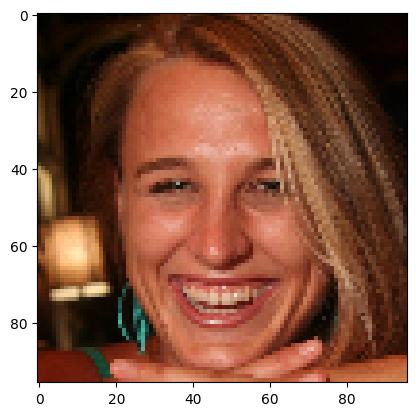

In [ ]:
plt.imshow(train_images[0])
plt.show()

We can view the class name by using the label number as an index in class_names!

In [ ]:
print(train_labels[0])
print(class_names[train_labels[0]])

4
happy


Let's see some more faces :)

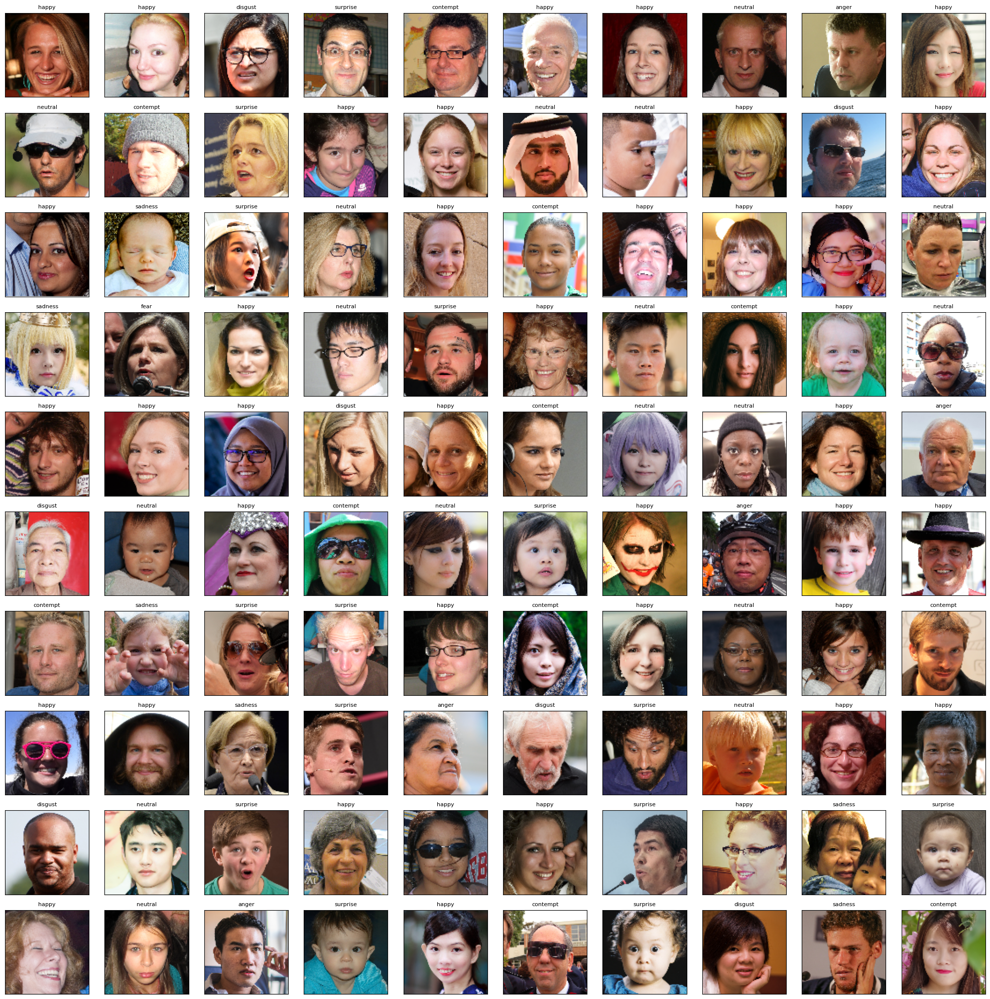

In [ ]:
plt.figure(figsize=(20, 20))  # width and height of figure
for i in range(100):  # take 100 images
    plt.subplot(10, 10, i + 1)  # plots 10x10
    plt.xticks([])  # Remove x-axis tick marks
    plt.yticks([])  # Remove y-axis tick marks
    plt.grid(False)
    plt.imshow(train_images[i], cmap=plt.cm.binary)  # Assume train_images are scaled between 0 and 1
    # Make sure class_names and train_labels are aligned and correct
    plt.title(class_names[train_labels[i]], fontsize=8)
plt.tight_layout()  # Adjust subplots to fit into the figure area.
plt.show()

## Cleaning Up Images

Taking a look at the distribution of labels across the images, it is not perfectly balanced. This could grow to be a problem for interpreting our accuracy of the models properly. If one class outnumbers the others by a large amount, our model may have inflated accuracy measurements as it begins to predict the class with the highest count.

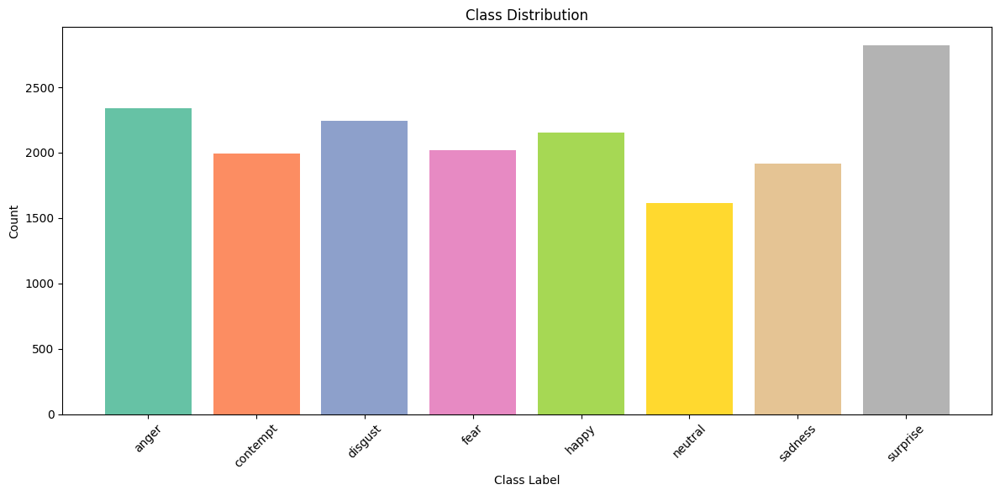

In [ ]:
import seaborn as sns # Seaborn has the pretty colors for graphing

unique_classes, class_counts = np.unique(train_labels, return_counts=True)
palette = sns.color_palette("Set2")


# plot class distribution
plt.figure(figsize=(12, 6))
plt.bar(unique_classes, class_counts, color=palette)
plt.title('Class Distribution')
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.xticks(unique_classes, [class_names[i] for i in unique_classes], rotation=45)  # Set x-axis labels to class names
plt.tight_layout()
plt.show()

for class_label, count in zip(unique_classes, class_counts):
    class_name = class_names[class_label]
    # print(f"{class_label}: {class_name} - {count} samples")

Yikes! Looks like some of our classes (surprise) have much more data than others. Let's even them out closer to 2000.

This method will undersample the majority classes by 750 images. This allows for us to acheive a soft balance of our training data.

In [ ]:
def balance_dataset(X, y):
    # Find the class with the maximum number of samples
    unique_classes, class_counts = np.unique(y, return_counts=True)
    max_samples = np.max(class_counts)

    margin = 750  # This is the number of images being taken away
    target_samples = max_samples - margin

    # Undersample the majority classes
    balanced_indices = []
    for class_label in unique_classes:
        indices = np.where(y == class_label)[0]

        if len(indices) > target_samples:
            balanced_indices.extend(np.random.choice(indices, target_samples, replace=False))
        else:
            balanced_indices.extend(indices)

    # Create balanced dataset
    X_balanced = X[balanced_indices]
    y_balanced = y[balanced_indices]

    return X_balanced, y_balanced

Next, we create variables for storing the rebalanced training data to be used on our classifiers.

In [ ]:
X_train_balanced, y_train_balanced = balance_dataset(train_images, train_labels)

# Shuffle data
indices = np.arange(X_train_balanced.shape[0])
np.random.shuffle(indices)

X_train_balanced = X_train_balanced[indices]
y_train_balanced = y_train_balanced[indices]

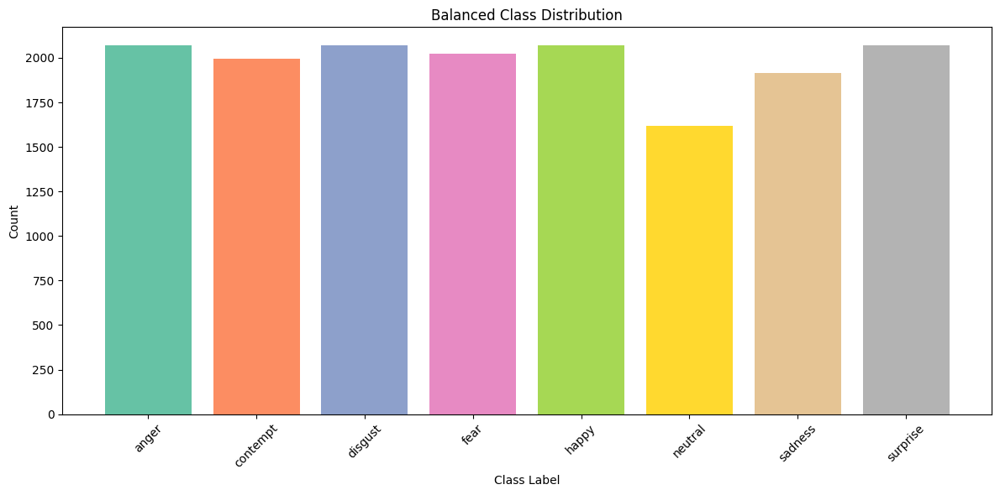

In [ ]:
unique_classes_balanced, class_counts_balanced = np.unique(y_train_balanced, return_counts=True)

plt.figure(figsize=(12, 6))
plt.bar(unique_classes_balanced, class_counts_balanced, color=palette)
plt.title('Balanced Class Distribution')
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.xticks(unique_classes_balanced, [class_names[i] for i in unique_classes_balanced], rotation=45)  # Set x-axis labels to class names
plt.tight_layout()
plt.show()

That's much better. Be careful when balancing data, because you will never want to oversample images. That will likely lead to overfitting once we train our model, it will focus on what information it finds in the duplicate images more than the information found in the unique images.

## Data Visualization

Plotted 5% of our training dataset

This is currently a scatterplot of the similarity of each image.

This is solely based on the raw image data alone (pixel color values), just to show that deep methods of pattern detection are necessary to seperate one image from one another.

This is a little silly, because of course all images are of human faces, and emotions take up only a tiny fraction of important information within the image. So ignoring the emotion/class of each image. Data wise they are essentially all the same.

In [ ]:
from sklearn.manifold import TSNE
import plotly.express as px

# Pull 5% out of our training data
num_samples = int(0.05 * X_train_balanced.shape[0])
random_indices = np.random.choice(X_train_balanced.shape[0], num_samples, replace=False)
sampled_images = X_train_balanced[random_indices]
sampled_labels = y_train_balanced[random_indices]

# Flatten the sampled image data
flattened_images = sampled_images.reshape(sampled_images.shape[0], -1)

# TSNE is a way to calculate similarity between two data points.
# We create 2 of these to have a 2d plot with an x-sim axis, and y-sim axis
tsne = TSNE(n_components=2, random_state=0)
projections = tsne.fit_transform(flattened_images)

# Create a datafrom from our similarity variables
import pandas as pd
df = pd.DataFrame({
    'tsne-1': projections[:, 0],
    'tsne-2': projections[:, 1],
    'label': [class_names[label] for label in sampled_labels]
})

# Plot!
fig = px.scatter(
    df, x='tsne-1', y='tsne-2',
    color='label', labels={'color': 'Label'}
)
fig.show()


For further analysis of our image data, here we are plotting the seperation of each class based on the two most important principal components.

Granted there is over 90 dimensions within our image data and this is the seperation based off of only the 2 with the highest variance.

Usually you would hope to see more seperation in your classes from these principal components, and the lack thereof within our dataset highlights how hard of a challenge it will be to train a classifier to be able to separate them.

Original shape: (17101, 96, 96, 3)


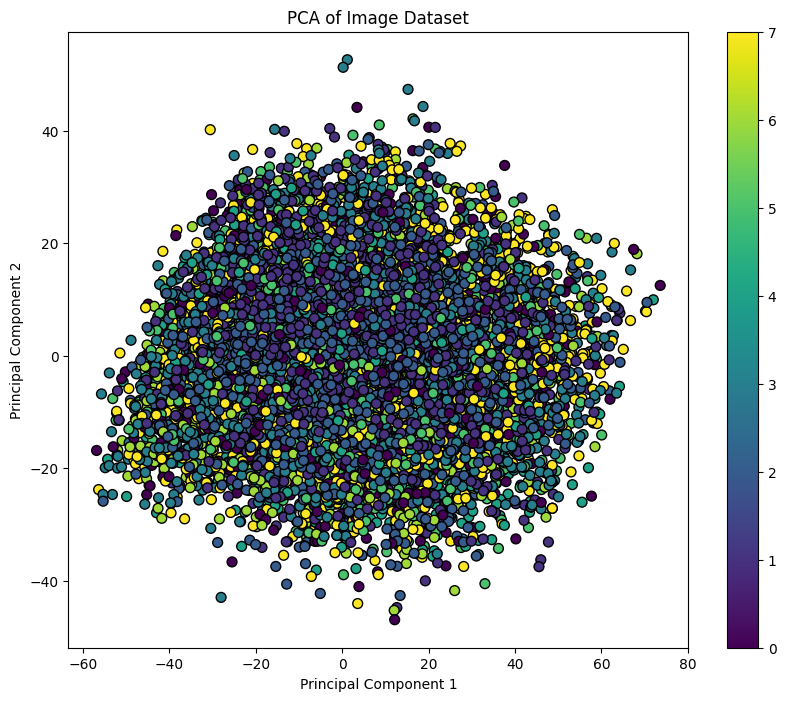

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Check initial shape
print("Original shape:", train_images.shape)

# Flatten the images: Assuming 'train_images' is [samples, height, width, channels]
n_samples, height, width, channels = train_images.shape
train_images_flat = train_images.reshape(n_samples, height * width * channels)

# Now apply PCA
pca = PCA(n_components=2)  # Reduce to two dimensions for visualization
principal_components = pca.fit_transform(train_images_flat)

# Plotting the results
plt.figure(figsize=(10, 8))
scatter = plt.scatter(principal_components[:, 0], principal_components[:, 1], c=train_labels, cmap='viridis', edgecolor='k', s=50)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Image Dataset')
plt.colorbar(scatter)
plt.show()


# SVM Classification

For each SVM, we will do our parameter tuning by doing cross validation on roughly 2000 images from the validation data set. This was added near the end of the project timeline and caused a small but noticeable increase in accuracy.

##Basic SVM

We're going to begin by training a classic SVM and on the raw pictures and see what kind of accuracy we get. Out of the box, SciKitLearn's SVC model can handle multiclassification by performing one versus one binary classification on each of our 8 classes. We can already predict that this model is going to be relatively innacurate, there are a couple reasons for this.
1. These images contain a large amount of features that are completely irrelevant to their classification. The SVM will have to learn to ignore this information which will impact its accuracy.
2. The features that do matter, such as the pixels that represent the positions of key facial features such as the nose, mouth and eyes and their relationship to emotion, is an extremely complex pattern that the SVM may have difficulty finding a separating hyperplane for, especially when represented as raw pixel data.
3. SVM's generally do not perform great on high dimensional data unlike CNN's and must be carefully feature engineered through resource intensive processes to produce accuracies and results comparable to CNN's. The Keras library for creating a CNN provides an efficient way to analyze images with optimal GPU and CPU resources, while the SciKit Learn's SVC implementation of SVM is not set up to handle such a resource intensive task.

In [ ]:
##Took about 20 mins
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
print(validation_images.shape)
print(validation_labels.shape)
validation_flat_images = validation_images.reshape(-1, 96 * 96 * 3)
X_flat_train = X_train_balanced.reshape(-1, 96 * 96 * 3)
X_flat_test = test_images.reshape(-1, 96 * 96 * 3)
param_grid = {
    'kernel': ['linear', 'rbf'],
    'C': [0.01, 0.1, 1, 10,],
    'gamma': [0.001, 0.01, 0.1, 'scale']
}

placeholder, stratified_validation_train_images, placeholder2, stratified_validation_labels = train_test_split(
    validation_flat_images, validation_labels, test_size=0.2, stratify=validation_labels, random_state=42)

grid_search = GridSearchCV(SVC(), param_grid, cv=5, n_jobs = -1, verbose = 20)
grid_search.fit(stratified_validation_train_images, stratified_validation_labels)
best_model = grid_search.best_estimator_
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best score: {grid_search.best_score_}")

(5406, 96, 96, 3)
(5406,)
Fitting 5 folds for each of 32 candidates, totalling 160 fits
Best parameters: {'C': 0.1, 'gamma': 0.001, 'kernel': 'linear'}
Best score: 0.27546509643283834


In [ ]:
##58 Minutes
classifier = SVC(**grid_search.best_params_)
classifier.fit(X_flat_train, y_train_balanced)

SVC(C=0.1, gamma=0.001, kernel='linear')

In [ ]:
#6 mins
test_pred = classifier.predict(X_flat_test)
print("Accuracy:", metrics.accuracy_score(test_labels, test_pred))

Accuracy: 0.36406533575317607


As expected, the simple SVM with no modifications performs poorly at merely 26% accuracy, however this doesn't mean that an SVM is terribly suited to this task, merely that we need to augment it. The best tool for that is to perform feature extraction, a way to convert our current set of features which represent the image, into a set of features that can better capture the important components that contribute to our classification, such as features that better represent facial geographic features and their position.

Using feature extraction methods we can combine the SVM's supervised learning model with human intuition, as most of our feature extraction methods are using human intuition that pinpoints what kinds of features would best have a relationship with an emotion classification. A great example of this: one of our feature extraction methods scans the image and produces an output with the edges of the pictures, we do this because we understand as humans that those components of a face are how emotions are represented on a face and those can be captured from things like the nose, mouth and eyes, which will be represented as edges. Once we've disambiguated our features and created a feature set that better captures the relationship between a picture of a face and its emotions, we should expect to see a higher accuracy

##SVM Trained On Features Extracted Using A Widely Available CNN


With this we use the Img2Vec library which contains the Resnet18 pretrained network to extract features from our image set.

As a quick note to explain some code choices, the library used normalizes all images passed in so we had to pass in unnormalized data, unlike what we do in each other SVM.

In [ ]:
##First we have to convert the images using the PIL libray so the Img2Vec library
## Took 10 mins
!pip install img2vec_pytorch -q
from img2vec_pytorch import Img2Vec
import tensorflow as tf
from PIL import Image
import os
import cv2
from sklearn import svm

img2vec = Img2Vec()
extracted_train_features = []
extracted_test_features = []
extracted_validate_features = []

unnormalized_train_features = X_train_balanced * 255.0
unnormalized_test_features = test_images * 255.0
unnormalized_validate_features = validation_images * 255.0


for i in range(len(unnormalized_train_features)):
  extracted_train_features.append(img2vec.get_vec(Image.fromarray(np.uint8(unnormalized_train_features[i]))))
for i in range(len(unnormalized_test_features)):
  extracted_test_features.append(img2vec.get_vec(Image.fromarray(np.uint8(unnormalized_test_features[i]))))
for i in range(len(unnormalized_validate_features)):
  extracted_validate_features.append(img2vec.get_vec(Image.fromarray(np.uint8(unnormalized_validate_features[i]))))

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:01<00:00, 43.3MB/s]


We will use a gaussian kernel for learning the decision boundary as it can seperate the classes from these complex relationships in an infinitely dimensional space and map it back down to our original feature space.

In [ ]:
grid_search = GridSearchCV(SVC(), param_grid, cv=5, n_jobs = -1, verbose = 20)
grid_search.fit(extracted_validate_features, validation_labels)
best_model = grid_search.best_estimator_
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best score: {grid_search.best_score_}")

Fitting 5 folds for each of 32 candidates, totalling 160 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning:

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



Best parameters: {'C': 1, 'gamma': 0.01, 'kernel': 'rbf'}
Best score: 0.35592241044695727


In [ ]:
img2vec_classifier = svm.SVC(**grid_search.best_params_)
img2vec_classifier.fit(extracted_train_features, y_train_balanced)

SVC(C=1, gamma=0.01)

In [ ]:
test_pred = img2vec_classifier.predict(extracted_test_features)
print("Accuracy:", metrics.accuracy_score(test_labels, test_pred))

Accuracy: 0.43303085299455535


##SVM Trained On Features Extracted Using HOG

For our second feature extraction method we will being using Histogram of Orientated Gradients. We expect this to increase our accuracy because it allows us to remove extraneous data while still preserving important information such as the angles of eyebrows and mouths, through the edge detection of HOG.

Below we'll display the conversion of 10 images to their equivalnet HOG's so you can get a better intuitive understanding of what is happening to the data set.

<ipython-input-60-a17833ba9825>:5: FutureWarning:

`multichannel` is a deprecated argument name for `hog`. It will be removed in version 1.0. Please use `channel_axis` instead.



(288,)


<ipython-input-60-a17833ba9825>:21: FutureWarning:

`multichannel` is a deprecated argument name for `hog`. It will be removed in version 1.0. Please use `channel_axis` instead.



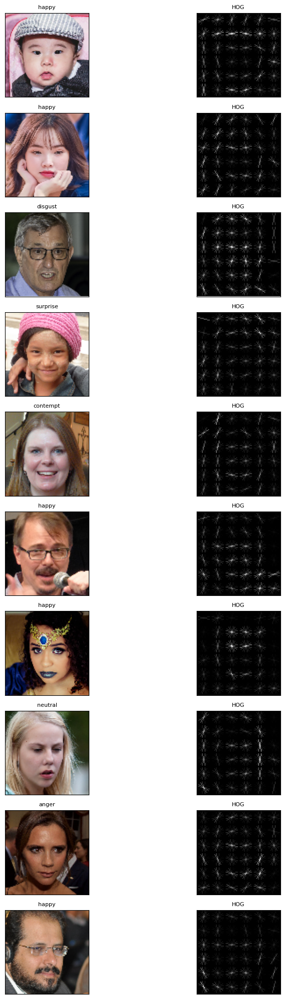

In [ ]:
from skimage.color import rgb2gray
from skimage.feature import hog

gray_img = rgb2gray(validation_images[0])
fb, hog_image = hog(gray_img, orientations=8, pixels_per_cell=(16, 16),
                      cells_per_block=(1, 1), visualize=True, multichannel=False)
print(fb.shape)

plt.figure(figsize=(10, 20))

# Assuming validation_images contains your images
for i in range(10):
    plt.subplot(10, 2, 2*i + 1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(validation_images[i], cmap=plt.cm.binary)
    plt.title(class_names[train_labels[i]], fontsize=8)

    gray_img = rgb2gray(validation_images[i])
    features, hog_image = hog(gray_img, orientations=8, pixels_per_cell=(16, 16),
                        cells_per_block=(1, 1), visualize=True, multichannel=False)
    plt.subplot(10, 2, 2*i + 2)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(hog_image, cmap=plt.cm.gray)
    plt.title('HOG', fontsize=8)

plt.tight_layout()
plt.show()

In [ ]:
#6 mins
from sklearn.model_selection import train_test_split
hog_test_features = []
hog_train_features = []
hog_validate_features = []
placeholder, stratified_validation_train_images, placeholder2, stratified_validation_labels = train_test_split(
    validation_images, validation_labels, test_size=0.2, stratify=validation_labels, random_state=42)
for img in test_images:
  img = rgb2gray(img)
  feature, _ = hog(img, orientations=9, pixels_per_cell=(8, 8),
                      cells_per_block=(2, 2), visualize=True, block_norm='L2-Hys')
  hog_test_features.append(feature)
for img in X_train_balanced:
  img = rgb2gray(img)
  feature, _ = hog(img, orientations=9, pixels_per_cell=(8, 8),
                      cells_per_block=(2, 2), visualize=True, block_norm='L2-Hys')
  hog_train_features.append(feature)
for img in stratified_validation_train_images:
  img = rgb2gray(img)
  feature, _ = hog(img, orientations=9, pixels_per_cell=(8, 8),
                      cells_per_block=(2, 2), visualize=True, block_norm='L2-Hys')
  hog_validate_features.append(feature)

hog_test_features = np.array(hog_test_features)
hog_train_features = np.array(hog_train_features)
validate_features = np.array(hog_validate_features)

In [ ]:
##Took 2 mins
grid_search = GridSearchCV(SVC(), param_grid, cv=5, n_jobs = -1, verbose = 20)
grid_search.fit(validate_features, stratified_validation_labels)
best_model = grid_search.best_estimator_
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best score: {grid_search.best_score_}")

Fitting 5 folds for each of 32 candidates, totalling 160 fits
Best parameters: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best score: 0.38174176480628097


In [ ]:
#Took 24mins
hog_classifier = SVC(**grid_search.best_params_)
hog_classifier.fit(hog_train_features, y_train_balanced)

SVC(C=10)

In [ ]:
#Took 4mins
hog_test_pred = hog_classifier.predict(hog_test_features)
print("Accuracy:",metrics.accuracy_score(test_labels, hog_test_pred))

Accuracy: 0.5070780399274047


From our SVM experiments, we can see that the accuracies are as follows:

* Basic SVM (No feature extraction): 36.4% accurate
* ResNet18 feature extracted SVM: 43.3% accurate
* HOG feature extracted SVM: 51.07% accurate

In the end, as expected feature extraction significantly increased our classification accuracy, as we saw a 14% increase in our classic SVM to our HOG feature extraction SVM.

Now lets see how a convolutional neural network that can encapsulate translational invariance performs!

# Convolutional Neural Network Classification

The idea of using a CNN as a classifier for this task comes from the idea of translational invariance. This component allows convolutional neural networks to capture feature detection from an image irregardless of spatial location which is important for images of someone being happy, for example, in different areas of the image. We can capture the smile and the eye position across different variations of the same image despite the data looking different numerically. This component of CNN's is integral to their ability to detect features of an image across different types of images and we hope will be useful for detection of the emotional classification of an image throughout our dataset. Pooling layers throughout the models will increase data abstraction while reducing sensitivity to the exact location of features within the regions pooled.

For our CNN, we will need a few imports as well. First off, tensorflow is a library built for creating efficient and easy to understand neural networks. from tensor flow we import keras, a library for creating intuitive, deep neural networks.

Keras operates on layers, a neat bundled up way to define custom neural network architecture. We import a few different types of layers: Dense, Flatten, Dropout, BachNormilization, Conv2D, and MaxPooling2D.

We also import a predefined neural network architecture called ResNet50. This will be used for transfer learning training to find the best neural network for our classification task.

In conjunction, the Adam optimizer is used to in the complilation section as well as a few callbacks for more efficient training of our models.

In [7]:
!pip install keras-tuner -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 4.3 MB/s eta 0:00:00


In [8]:
import json
import tensorflow as tf
import keras_tuner as kt
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, Dropout, BatchNormalization, Conv2D, MaxPooling2D
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing import image
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2L
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2
from tensorflow.keras.mixed_precision import set_global_policy
from tensorflow.keras.regularizers import l1, l2, L1L2
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

## One-Hot Encoding

In order to apply the softmax activation function at the end of our CNN layers to obtain a classification based on probability, we must modify the training and validation labels to be one-hot encoded. This also allows us to use a categorical cross entropy loss function for our network, which works best for this problem.

This makes every label that only has one value (0-7) a vector of length 8 where the corresponding value in the labels (0-7) becomes a 1 in the vector and every other value becomes 0. ie.

A label of "3" in the train_labels becomes:
\begin{equation}
\mathbf{v} = \begin{bmatrix}
0 \\
0 \\
0 \\
1 \\
0 \\
0 \\
0 \\
0 \\
\end{bmatrix}
\end{equation}

In [ ]:
y_train_one_hot = to_categorical(y_train_balanced, num_classes=8)
y_val_one_hot = to_categorical(validation_labels, num_classes=8)
y_test_one_hot = to_categorical(test_labels, num_classes=8)

In [ ]:
## See the shape of the labels after one-hot encoding
print("Before one-hot encoding")
print(y_train_balanced.shape)
print(validation_labels.shape)
print(test_labels.shape)

print("After one-hot encoding")
print(y_train_one_hot.shape)
print(y_val_one_hot.shape)
print(y_test_one_hot.shape)

Before one-hot encoding
(15823,)
(5406,)
(2755,)
After one-hot encoding
(15823, 8)
(5406, 8)
(2755, 8)


## Generators for our CNN

To avoid overfitting during training and to improve performance, we will distribute images to our CNN in batches generated by a keras generator package. This not only slightly augments the images each batch while being fed into the model, but makes use of background threads and processes to load in data on-the-fly while the current batch is training. This can help improve a model's validation and testing accuracy as well as aleive strain on memory and processor resources while training. Additionally, batching our images from a generator helps with backpropagation and gradient descent allowing us to perform batch-gradient descent and hopefully escape shallow minima in our loss function more easily.

Let's create a generator for the training images that slightly augments the shape and orientation of the images being fed into the model as well as a generator for the validation set that includes no augmentation.

Through testing, we found that using a batch size of 32, a rotation value of 5, and a zoom and shear range of 0.1 worked best for our generator to avoid overfitting.

In [ ]:
batch_size = 32

X_train_balanced = X_train_balanced.astype('float32')
X_validation = validation_images.astype('float32')

# Create a training generator with augmentation
data_generator = tf.keras.preprocessing.image.ImageDataGenerator(
    horizontal_flip=True,
    rotation_range=5,
    zoom_range=0.1,
    shear_range=0.1,
    fill_mode='nearest'
)

# Create a validation generator, without augmentation
validation_data_generator = tf.keras.preprocessing.image.ImageDataGenerator()
validation_generator = validation_data_generator.flow(X_validation, y_val_one_hot, batch_size)

# Create training generator and the steps to take per epoch
train_generator = data_generator.flow(X_train_balanced, y_train_one_hot, batch_size)
steps_per_epoch = X_train_balanced.shape[0] // batch_size

Now let's see the augmented images coming straight from the training generator

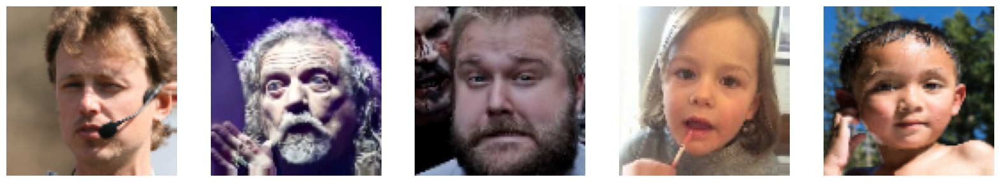

In [ ]:
# Get a batch of images and labels from the generator
augmented_images, augmented_labels = next(train_generator)

num_images_to_show = 5

fig, axes = plt.subplots(1, num_images_to_show, figsize=(20, 5))

# Iterate over the images and plot them
for i in range(num_images_to_show):
    image = augmented_images[i]
    axes[i].imshow(image)
    axes[i].axis('off')

plt.show()

These look very similar to the original images, but just different enough to prevent as much overfitting from our models as possible.

## Hyperparameters and Tuning

One big problem with training and finding the best model for neural networks and convolutional neural networks is finding the right combination of hyperparameters that produce the best model.

We want our model to train fast enough to learn big patterns in the data, but with enough generalization to acheive good validation/test accuracy as well.

Luckily, we can focus on a few big hyperparameters and "tune" them with a package called keras-tuner.

After some trial end error and research into the best hyperparameters to tune, we found that focusing on the regularization amount, the learning rate, the amount of units in the final dense layer after the transfer learning, and the dropout rate for the layer after the final dense layer had the best results.

On another interesting note, We found that when freezing any amount of the predefined model's layers, the training and validation accuracy suffered immensly. If we left ResNet50's layers frozen and only trained the final dense layers we added, we could not acheive a validation accuracy over 30%. (More on this result in the results section)

Lets look at how we defined our models and tuned them.


### ResNet50

For our ResNet50 model, we used the imagenet weights because it has been shown that ResNet50 if very successful at clasifying a dataset of random objects corresponding to 1000 different classes.

ResNet stands for residual network which is the idea of "injecting" the original input signal from the data after blocks of convolutions have taken place. This not only helps mitigate the exploding/vanishing gradient problem during back propagation, but also provides a regularization effect to the data, helping prevent overfitting.

The diagram below illustrates the architecture of ResNet50 and shows how the signal skips "blocks" of operations to be convolved in future blocks.

Block diagram of Resnet-50 1 by 2 architecture.

<a href="https://www.researchgate.net/figure/Block-diagram-of-Resnet-50-1-by-2-architecture_fig4_326198791"><img src="https://www.researchgate.net/publication/326198791/figure/fig4/AS:1086420559101961@1636034254287/Block-diagram-of-Resnet-50-1-by-2-architecture.jpg" alt="Block diagram of Resnet-50 1 by 2 architecture."/></a>

Explicit Content Detection System: An Approach towards a Safe and Ethical Environment - Scientific Figure on ResearchGate. Available from: https://www.researchgate.net/figure/Block-diagram-of-Resnet-50-1-by-2-architecture_fig4_326198791 [accessed 8 Apr, 2024]

For our custom model, we strip off the top layer of ResNet50 and use our own 96 x 96 x 3 input layer, joining the rest of the layers with a Flatten, Dense, Dropout, and Dense softmax output layer at the end.

Although this makes training time longer, we allow all layers of the base ResNet50 model to be trainable during the back propagation stage. This helped our accuracy skyrocket.

We set an upper limit on the amount of units in the Dense layer after the base model because using more than 512 with this model causes too much RAM usage to be effective.

In [ ]:
def build_model(hp):
    base_model = ResNet50(include_top=False, weights='imagenet', input_shape=(96, 96, 3), pooling='avg')
    base_model.trainable = True  # Setting to False results in terrible accuracy

    # Define regularization
    reg = l2(hp.Float('l2_reg', min_value=1e-5, max_value=1e-2, sampling='LOG', default=1e-4))

    model = Sequential([
        base_model,
        Flatten(),
        Dense(units=hp.Int('units', min_value=32, max_value=512, step=32),
              activation='relu',
              kernel_regularizer=reg),  # Apply L2 regularization
        Dropout(rate=hp.Float('dropout', min_value=0.0, max_value=0.5, default=0.25, step=0.05)),
        Dense(8, activation='softmax', kernel_regularizer=reg)
    ])

    learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [ ]:
## Define the tuner with an objective of achieving the best validation accuracy
tuner = kt.Hyperband(build_model,
                     objective='val_accuracy',
                     max_epochs=10,
                     directory='kt_dir',
                     project_name='kt_resnet')

## Callbacks
early_stopping = EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model.keras', monitor='val_accuracy', save_best_only=True)

## Start a bracketed search of the best hyperparameters
tuner.search(train_generator,
             validation_data=validation_generator,
             epochs=10,
             callbacks=[early_stopping, model_checkpoint])

Trial 30 Complete [00h 09m 04s]
val_accuracy: 0.6163522005081177

Best val_accuracy So Far: 0.6579726338386536
Total elapsed time: 01h 57m 23s


In [ ]:
## Get the best hyperparameters and build the model
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
resnet_model = build_model(best_hps)

In [ ]:
print('The best hyperparameters are:')
print(f"L2 regularization: {best_hps.get('l2_reg')}")
print(f"Units: {best_hps.get('units')}")
print(f"Dropout rate: {best_hps.get('dropout')}")
print(f"Learning rate: {best_hps.get('learning_rate')}")

The best hyperparameters are:
L2 regularization: 0.0001773646922911197
Units: 512
Dropout rate: 0.4
Learning rate: 0.0001


Let's train the model from scratch using the best hyperparameters we found through tuning. We have an early stopping callback function to stop training if the validation loss is not improving, so as to not overfit the model on the training data before we evaluate it.

In [ ]:
## Train the model over 50 epochs or stop when validation loss is not improving.
resnet_history = resnet_model.fit(train_generator,
                    validation_data=validation_generator,
                    epochs=50,
                    callbacks=[early_stopping, model_checkpoint, ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3)])

Epoch 1/50
495/495 [==============================] - 79s 105ms/step - loss: 1.8257 - accuracy: 0.3840 - val_loss: 3.4664 - val_accuracy: 0.1243 - lr: 1.0000e-04
Epoch 2/50
495/495 [==============================] - 51s 102ms/step - loss: 1.2919 - accuracy: 0.5774 - val_loss: 1.2478 - val_accuracy: 0.5868 - lr: 1.0000e-04
Epoch 3/50
495/495 [==============================] - 51s 103ms/step - loss: 1.0903 - accuracy: 0.6527 - val_loss: 1.1369 - val_accuracy: 0.6363 - lr: 1.0000e-04
Epoch 4/50
495/495 [==============================] - 51s 102ms/step - loss: 0.9625 - accuracy: 0.7019 - val_loss: 1.1472 - val_accuracy: 0.6426 - lr: 1.0000e-04
Epoch 5/50
495/495 [==============================] - 49s 99ms/step - loss: 0.8411 - accuracy: 0.7432 - val_loss: 1.2844 - val_accuracy: 0.6152 - lr: 1.0000e-04
Epoch 6/50
495/495 [==============================] - 49s 99ms/step - loss: 0.7430 - accuracy: 0.7850 - val_loss: 1.3994 - val_accuracy: 0.5899 - lr: 1.0000e-04
Epoch 7/50
495/495 [==========

In [ ]:
# Convert numpy floats to Python floats for JSON serialization
history_dict = {key: [float(val) for val in values] for key, values in resnet_history.history.items()}

# Dump into string
json_string = json.dumps(history_dict, indent=4)

# Define the file path
save_path = "/content/drive/My Drive/CS345 Project/resnet_history.json"

# Create directory if it does not exist
os.makedirs(os.path.dirname(save_path), exist_ok=True)

# Write to the JSON file
with open(save_path, 'w') as f:
    f.write(json_string)

print(f"History saved as JSON to '{save_path}'")

History saved as JSON to '/content/drive/My Drive/CS345 Project/resnet_history.json'


In [ ]:
# Load the resnet_history from a JSON file
load_path = "/content/drive/My Drive/CS345 Project/resnet_history.json"
with open(load_path, 'r') as f:
    history_dict = json.load(f)

# Create a simple class to mimic Keras' History object
class History:
    def __init__(self, history):
        self.history = history

# Load the history into the variable
resnet_history = History(history_dict)

print(f"History loaded from '{load_path}'")


History loaded from '/content/drive/My Drive/CS345 Project/resnet_history.json'


In [ ]:
# Save the final model
resnet_model.save('/content/drive/My Drive/CS345 Project/final_resnet_model.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [14]:
# Load the model if ever needed
resnet_model = keras.models.load_model('/content/drive/My Drive/CS345 Project/final_resnet_model.h5')

In [ ]:
resnet_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 flatten_1 (Flatten)         (None, 2048)              0         
                                                                 
 dense_2 (Dense)             (None, 512)               1049088   
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_3 (Dense)             (None, 8)                 4104      
                                                                 
Total params: 24640904 (94.00 MB)
Trainable params: 24587784 (93.79 MB)
Non-trainable params: 53120 (207.50 KB)
_________________________________________________________________


Let's evaluate our model and perform a round of predictions on the test set. We will store these results in variables that we can look at in the results section.

In [ ]:
resnet_eval = resnet_model.evaluate(test_images, y_test_one_hot)
resnet_pred = resnet_model.predict(test_images)

87/87 [==============================] - 3s 20ms/step


### CNN-10

This model architecture is suggested from the paper:

> Emmanuel Gbenga Dada, David Opeoluwa Oyewola, Stephen Bassi Joseph, Onyeka Emebo, & Olugbenga Oluwagbemi. (2023). Facial Emotion Recognition and Classification Using the Convolutional Neural Network-10 (CNN-10). Applied Computational Intelligence and Soft Computing, 2023, 1–19. https://doi.org/10.1155/2023/2457898

They created a simple convolutional architecture designed for usage on human faces that was able to:
> "detect spatial features, manage translation invariance, understand expressive feature representations, gather global context, and achieve scalability, adaptability, and interoperability with transfer learning methods."

We chose to use this model as it is very simple compared to ResNet50's dense architecture and may prove insightful for what kind of architecture is best for our dataset and our classification problem.

From the paper, we show the visual representation of this model and its layers:

_CNN-10 Layer Diagram_
![CNN-10 Architecture Diagram](https://drive.google.com/uc?export=view&id=16I39lXDYaaVIWKqXpKzws1gtfriNUygy)

The paper was not specific about dropout rates, dense layer units, or learning rate, so once again we will use keras tuner to find the best hyperparameters for the model given our dataset.

In [ ]:
def build_model(hp):
    model = keras.Sequential()

    # First Convolutional Layer
    model.add(layers.Conv2D(32, kernel_size=(3, 3), input_shape=(96, 96, 3), activation='relu'))

    # Second Convolutional Layer
    model.add(layers.Conv2D(32, kernel_size=(3, 3), activation='relu'))

    # Leaky ReLU Layer
    model.add(layers.LeakyReLU(alpha=0.5))

    # Batch Normalization Layer
    model.add(layers.BatchNormalization())

    # Max Pooling Layer
    model.add(layers.MaxPooling2D(pool_size=(2, 2)))

    # Dropout Layer with tunable rate
    hp_dropout_rate = hp.Float('dropout_1', min_value=0.1, max_value=0.5, step=0.1)
    model.add(layers.Dropout(hp_dropout_rate))

    # Flatten layer
    model.add(layers.Flatten())

    # First Dense Layer with tunable units
    hp_units = hp.Int('units', min_value=32, max_value=256, step=32)
    model.add(layers.Dense(hp_units, activation='relu'))

    # Dropout Layer with tunable rate
    hp_dropout_rate = hp.Float('dropout_2', min_value=0.1, max_value=0.5, step=0.1)
    model.add(layers.Dropout(hp_dropout_rate))

    # Output layer
    model.add(layers.Dense(8, activation='softmax'))

    learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [ ]:
## Define the tuner with an objective of achieving the best validation accuracy
tuner = kt.Hyperband(build_model,
                     objective='val_accuracy',
                     max_epochs=10,
                     directory='kt_dir',
                     project_name='kt_cnn10')

## Callbacks
early_stopping = EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model_cnn10.keras', monitor='val_accuracy', save_best_only=True)

## Start a bracketed search of the best hyperparameters
tuner.search(train_generator,
             validation_data=validation_generator,
             epochs=10,
             callbacks=[early_stopping, model_checkpoint])

Trial 30 Complete [00h 06m 07s]
val_accuracy: 0.46004438400268555

Best val_accuracy So Far: 0.5419903993606567
Total elapsed time: 01h 09m 04s


In [ ]:
## Get the best hyperparameters and build the model
best_hps_cnn10 = tuner.get_best_hyperparameters(num_trials=1)[0]
cnn10_model = build_model(best_hps_cnn10)

In [ ]:
print('The best hyperparameters are:')
print(f"Units: {best_hps_cnn10.get('units')}")
print(f"Dropout_1 rate: {best_hps_cnn10.get('dropout_1')}")
print(f"Dropout_2 rate: {best_hps_cnn10.get('dropout_2')}")
print(f"Learning rate: {best_hps_cnn10.get('learning_rate')}")

The best hyperparameters are:
Units: 224
Dropout_1 rate: 0.1
Dropout_2 rate: 0.2
Learning rate: 0.001


We will train the model from scratch using the best hyperparameters we found through tuning. The model will stop when validation loss is not showing improvement and will produce a model that has minimal overfitting.

In [ ]:
## Train the model over 50 epochs or stop when validation loss is not improving.
cnn10_history = cnn10_model.fit(train_generator,
                    validation_data=validation_generator,
                    epochs=50,
                    callbacks=[early_stopping, model_checkpoint, ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3)])

Epoch 1/50
495/495 [==============================] - 39s 76ms/step - loss: 1.9377 - accuracy: 0.2998 - val_loss: 1.7507 - val_accuracy: 0.3711 - lr: 0.0010
Epoch 2/50
495/495 [==============================] - 37s 74ms/step - loss: 1.6374 - accuracy: 0.3767 - val_loss: 1.5129 - val_accuracy: 0.4314 - lr: 0.0010
Epoch 3/50
495/495 [==============================] - 36s 72ms/step - loss: 1.5372 - accuracy: 0.4206 - val_loss: 1.6131 - val_accuracy: 0.4166 - lr: 0.0010
Epoch 4/50
495/495 [==============================] - 36s 74ms/step - loss: 1.4651 - accuracy: 0.4535 - val_loss: 1.4094 - val_accuracy: 0.4737 - lr: 0.0010
Epoch 5/50
495/495 [==============================] - 36s 74ms/step - loss: 1.4162 - accuracy: 0.4727 - val_loss: 1.3544 - val_accuracy: 0.5013 - lr: 0.0010
Epoch 6/50
495/495 [==============================] - 36s 72ms/step - loss: 1.3595 - accuracy: 0.4930 - val_loss: 1.3863 - val_accuracy: 0.4863 - lr: 0.0010
Epoch 7/50
495/495 [==============================] - 36s 

In [ ]:
# Convert numpy floats to Python floats for JSON serialization
history_dict = {key: [float(val) for val in values] for key, values in cnn10_history.history.items()}

# Dump into string
json_string = json.dumps(history_dict, indent=4)

# Define the file path
save_path = "/content/drive/My Drive/CS345 Project/cnn10_history.json"

# Create directory if it does not exist
os.makedirs(os.path.dirname(save_path), exist_ok=True)

# Write to the JSON file
with open(save_path, 'w') as f:
    f.write(json_string)

print(f"History saved as JSON to '{save_path}'")

History saved as JSON to '/content/drive/My Drive/CS345 Project/cnn10_history.json'


In [ ]:
# Load the cnn10_history from a JSON file
load_path = "/content/drive/My Drive/CS345 Project/cnn10_history.json"
with open(load_path, 'r') as f:
    history_dict = json.load(f)

# Create a simple class to mimic Keras' History object
class History:
    def __init__(self, history):
        self.history = history

# Load the history into the variable
cnn10_history = History(history_dict)

print(f"History loaded from '{load_path}'")

History loaded from '/content/drive/My Drive/CS345 Project/cnn10_history.json'


In [ ]:
# Save the final model
cnn10_model.save('/content/drive/My Drive/CS345 Project/final_cnn10_model.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Load the model if ever needed
cnn10_model = keras.models.load_model('/content/drive/My Drive/CS345 Project/final_cnn10_model.h5')

In [ ]:
cnn10_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 94, 94, 32)        896       
                                                                 
 conv2d_3 (Conv2D)           (None, 92, 92, 32)        9248      
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 92, 92, 32)        0         
                                                                 
 batch_normalization_1 (Bat  (None, 92, 92, 32)        128       
 chNormalization)                                                
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 46, 46, 32)        0         
 g2D)                                                            
                                                                 
 dropout_2 (Dropout)         (None, 46, 46, 32)       

We can see our model has 8 million trainable parameters with most of them coming from the dense fully connected layers at the end of the network.

In [ ]:
cnn10_eval = cnn10_model.evaluate(test_images, y_test_one_hot)
cnn10_pred = cnn10_model.predict(test_images)

87/87 [==============================] - 0s 4ms/step


## Pre-defined Convolutional Neural Network

### ConvNet

The last architecture we tested had a complexity somewhere between our transfer learning ResNet50's architecture and the simple CNN-10 architecture. This model was produced based on the paper:

> Debnath, T., Reza, M. M., Rahman, A., Beheshti, A., Band, S. S., & Alinejad-Rokny, H. (2022). Four-layer ConvNet to facial emotion recognition with minimal epochs and the significance of data diversity. Scientific Reports, 12(1), 6991. https://doi.org/10.1038/s41598-022-11173-0

This paper suggests that 3 convolutional layers, each containing 2 convolutional passes, a batch normailization, a pooling layer, and a dropout layer produces great results specifically on human emotion detection.

Interestingly, we tried the model with and without the BatchNormalization() layers because the paper suggested it, and without the BatchNormalization(), the model performs terribly on our data! We believe this to be because every BatchNormalization() normalizes the data output from each activation function which leads to a more stable convergence and faster training times.

Let's look at the model architecture as illustrated in the paper:

_Block Diagram of ConvNet Architecture_
<a href="https://media.springernature.com/full/springer-static/image/art%3A10.1038%2Fs41598-022-11173-0/MediaObjects/41598_2022_11173_Fig8_HTML.png"><img src="https://media.springernature.com/full/springer-static/image/art%3A10.1038%2Fs41598-022-11173-0/MediaObjects/41598_2022_11173_Fig8_HTML.png" alt="Block diagram of ConvNet architecture."/></a>

In [ ]:
#1st convolution layer
convnet_model = Sequential()

convnet_model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', input_shape=(96, 96, 3)))
convnet_model.add(Conv2D(64,kernel_size= (3, 3), activation='relu'))
convnet_model.add(BatchNormalization())
convnet_model.add(MaxPooling2D(pool_size=(2,2), strides=(2, 2)))
convnet_model.add(Dropout(0.5))

#2nd convolution layer
convnet_model.add(Conv2D(64, (3, 3), activation='relu'))
convnet_model.add(Conv2D(64, (3, 3), activation='relu'))
convnet_model.add(BatchNormalization())
convnet_model.add(MaxPooling2D(pool_size=(2,2), strides=(2, 2)))
convnet_model.add(Dropout(0.5))

#3rd convolution layer
convnet_model.add(Conv2D(128, (3, 3), activation='relu'))
convnet_model.add(Conv2D(128, (3, 3), activation='relu'))
convnet_model.add(BatchNormalization())
convnet_model.add(MaxPooling2D(pool_size=(2,2), strides=(2, 2)))

convnet_model.add(Flatten())

#fully connected neural networks
convnet_model.add(Dense(1024, activation='relu'))
convnet_model.add(Dropout(0.2))
convnet_model.add(Dense(1024, activation='relu'))
convnet_model.add(Dropout(0.2))

convnet_model.add(Dense(8, activation='softmax'))

# convnet_model.summary()

#Compliling the convnet_model
convnet_model.compile(loss='categorical_crossentropy',
              optimizer=Adam(),
              metrics=['accuracy'])

In [ ]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model_cnn10.keras', monitor='val_accuracy', save_best_only=True)

convnet_history = convnet_model.fit(train_generator,
                    validation_data=validation_generator,
                    epochs=50,
                    callbacks=[early_stopping, model_checkpoint, ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3)]
                                    )

Epoch 1/50
495/495 [==============================] - 42s 71ms/step - loss: 2.2226 - accuracy: 0.2312 - val_loss: 1.8635 - val_accuracy: 0.3052 - lr: 0.0010
Epoch 2/50
495/495 [==============================] - 36s 73ms/step - loss: 1.7531 - accuracy: 0.3292 - val_loss: 1.6899 - val_accuracy: 0.3748 - lr: 0.0010
Epoch 3/50
495/495 [==============================] - 33s 67ms/step - loss: 1.6306 - accuracy: 0.3887 - val_loss: 1.6145 - val_accuracy: 0.3877 - lr: 0.0010
Epoch 4/50
495/495 [==============================] - 34s 68ms/step - loss: 1.5303 - accuracy: 0.4203 - val_loss: 1.3546 - val_accuracy: 0.4856 - lr: 0.0010
Epoch 5/50
495/495 [==============================] - 33s 66ms/step - loss: 1.4414 - accuracy: 0.4585 - val_loss: 1.4988 - val_accuracy: 0.4356 - lr: 0.0010
Epoch 6/50
495/495 [==============================] - 33s 67ms/step - loss: 1.3823 - accuracy: 0.4839 - val_loss: 1.3424 - val_accuracy: 0.5085 - lr: 0.0010
Epoch 7/50
495/495 [==============================] - 33s 

In [ ]:
# Convert numpy floats to Python floats for JSON serialization
history_dict = {key: [float(val) for val in values] for key, values in convnet_history.history.items()}

# Dump into string
json_string = json.dumps(history_dict, indent=4)

# Define the file path
save_path = "/content/drive/My Drive/CS345 Project/convnet_history.json"

# Create directory if it does not exist
os.makedirs(os.path.dirname(save_path), exist_ok=True)

# Write to the JSON file
with open(save_path, 'w') as f:
    f.write(json_string)

print(f"History saved as JSON to '{save_path}'")

History saved as JSON to '/content/drive/My Drive/CS345 Project/convnet_history.json'


In [ ]:
# Load the convnet_history from a JSON file
load_path = "/content/drive/My Drive/CS345 Project/convnet_history.json"
with open(load_path, 'r') as f:
    history_dict = json.load(f)

# Create a simple class to mimic Keras' History object
class History:
    def __init__(self, history):
        self.history = history

# Load the history into the variable
convnet_history = History(history_dict)

print(f"History loaded from '{load_path}'")

History loaded from '/content/drive/My Drive/CS345 Project/convnet_history.json'


In [ ]:
# Save the final model
convnet_model.save('/content/drive/My Drive/CS345 Project/final_convnet_model.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [9]:
# Load the model if ever needed
convnet_model = keras.models.load_model('/content/drive/My Drive/CS345 Project/final_convnet_model.h5')

In [ ]:
convnet_eval = convnet_model.evaluate(test_images, y_test_one_hot)
convnet_pred = convnet_model.predict(test_images)

87/87 [==============================] - 1s 9ms/step


In [ ]:
convnet_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 94, 94, 64)        1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 92, 92, 64)        36928     
                                                                 
 batch_normalization (Batch  (None, 92, 92, 64)        256       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 46, 46, 64)        0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 46, 46, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 44, 44, 64)        3

# Results/Interpretation

## Discussion of SVM Accuracy

* Basic SVM (No feature extraction): 36.4% accurate
* ResNet18 feature extracted SVM: 43.3% accurate
* HOG feature extracted SVM: 51.07% accurate

We trained 3 different SVM models, one of which was a simple SVM with no feature extraction steps, expectedly, that model performed the worse. However unexpectedly, the simple HOG filter performed significatly better than the Resnet18 feature extracter.

After some discussion and research into the Resnet18 model this seems to be because the Resnet18 feature extractor is trained to extract meaningful classification features for any images, and so was as not as useful as expected given the nature of facial emotion classification being based on the smallest of changes in geographic facial landmarks.

While the accuracy of the SVM models never approached a level we found satisfying as a tool to be used in any professional setting, they worked excellently to show how feature extraction is a vital component in ensuring model accuracy on images. Furthermore, although our accuracy capped out at 51.07%, when compared to human tested accuracy on this data set, the HOG SVM actually was more accurate, which is quite the achievement and sets a strong baseline to show just how impressive the accuracies reached in our CNN training are.

Below we'll show a confusion matrix to visualize what kinds of classifications are being succesfully predicted and not.

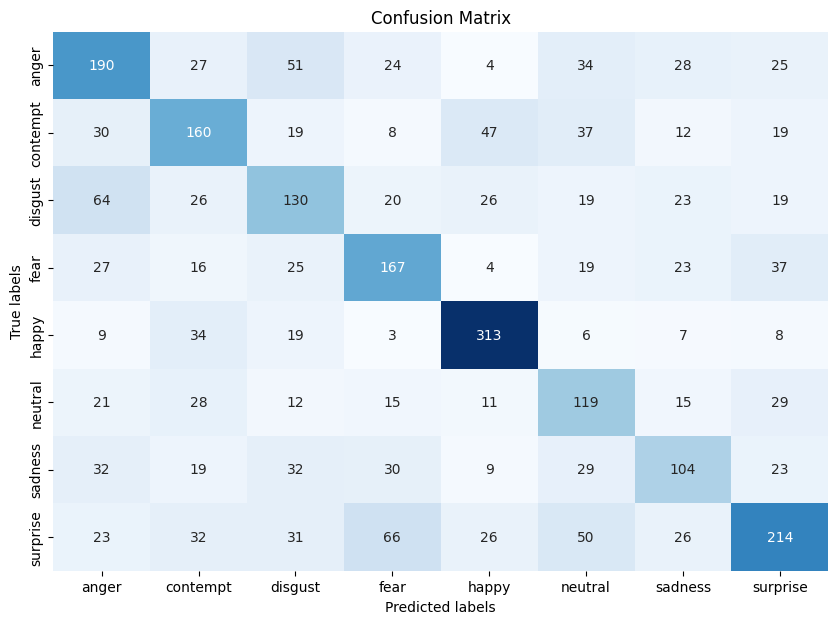

In [ ]:
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(test_labels, hog_test_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False, xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

As you can see from the results our tests, some classifications are significantly easier to classify than others, happy for example was classified correctly significantly more often than something like neutral or contempt, which makes sense as there is no "similar" expression to happiness, as there is for contempt/disgust/anger

## Discussion of CNN Accuracy

Resnet Parameters: 24640904

CNN10 Parameters: 15179784

ConvNet Paramters: 9782472

We trained 3 different convolutional learning models, one of which was based on transfer learning, and the highest accuracy reached was the Resnet50 transfer learned model with ~70% validation accuracy. Interestingly, ConvNet performed better than the CNN-10 model despite it having less parameters. Therefore, number of trainable parameters does not directly correlate to accuracy.

Additionally, when viewing the confusion matrices for each model we can see a common trend of which classes were misclassified in all of our models.

The pairs of most common misclassifications are as follows:

*   Anger and Disgust
*   Fear and Surprise
*   Nuetral and Contempt

> *Note:* The order of these pairs is reversible as misclassification occured both ways for these emotions.

Not to write off the performance of our model, but these are understandably some of the easiest emotions to mix up when lacking context. Someone who has just been jumpscared by a snake in the grass, and someone who has just been greeted by their friends for a surprise party are both very likely to have their mouth softly opened, and their eyebrows raised.

In [ ]:
from sklearn.metrics import confusion_matrix

## Get the labels for each CNN architecture
resnet_pred_labels = [np.argmax(i) for i in resnet_pred]
resnet_pred_labels_names = [class_names[i] for i in resnet_pred_labels]

cnn10_pred_labels = [np.argmax(i) for i in cnn10_pred]
cnn10_pred_labels_names = [class_names[i] for i in cnn10_pred_labels]

convnet_pred_labels = [np.argmax(i) for i in convnet_pred]
convnet_pred_labels_names = [class_names[i] for i in convnet_pred_labels]

## Create confusion matrix for each CNN model
resnet_cm = confusion_matrix(test_labels, resnet_pred_labels)
cnn10_cm = confusion_matrix(test_labels, cnn10_pred_labels)
convnet_cm = confusion_matrix(test_labels, convnet_pred_labels)

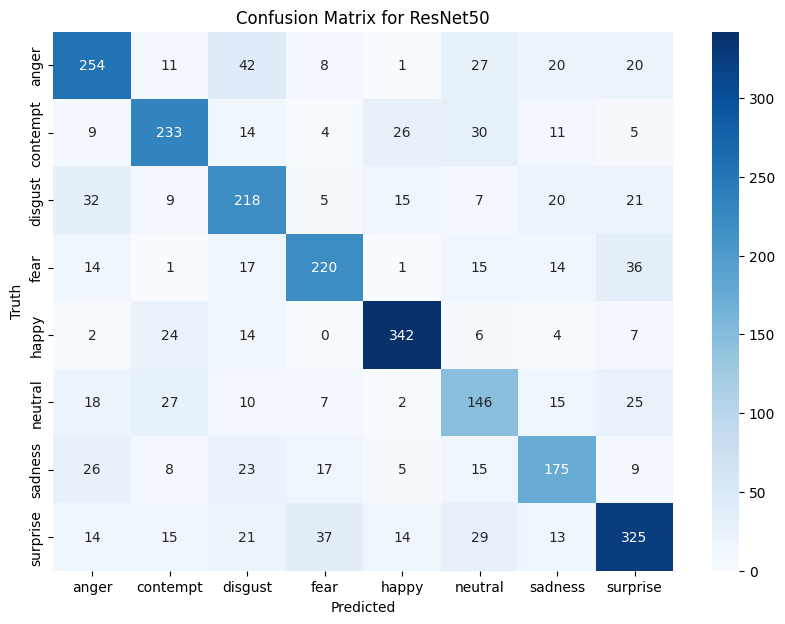

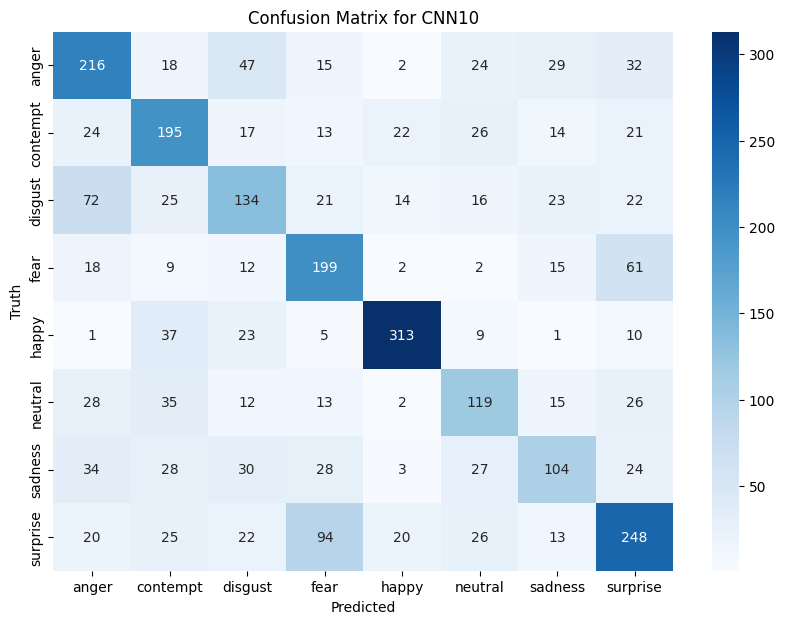

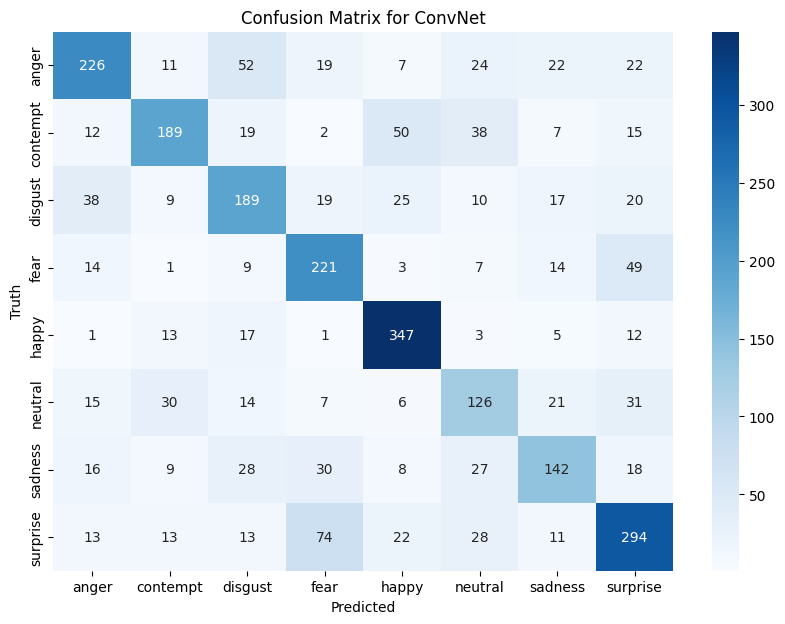

In [ ]:
## Plot confusion matrices
import seaborn as sn

plt.figure(figsize=(10,7))
sn.heatmap(resnet_cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Confusion Matrix for ResNet50')
plt.show()

plt.figure(figsize=(10,7))
sn.heatmap(cnn10_cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Confusion Matrix for CNN10')
plt.show()

plt.figure(figsize=(10,7))
sn.heatmap(convnet_cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Confusion Matrix for ConvNet')
plt.show()

## Accuracy and Loss Analysis

Here are 3 plots for each CNN model's Accuracy and Loss.

As shown in the graphs each model converges very quickly in less than 10 epochs and plateau in validation accuracy. We implemented early stopping as a callback function which gave each model the ability to stop training when it was not able to improve the val_loss in a reasonable amount of time.

It is apparent that all models at the halfway point of their total epochs have found a decision surface that represents most of the data and begins to overfit on the training set. This phenomenon occurs for all 3 models, and with further analysis we may be able to highlight why the models don't perform the greatest on this data.

### ResNet50 Accuracy/Loss

The ResNet model quickly found a decision surface within 2 epochs and began to overfit at around 6 epochs as the loss started to increase.

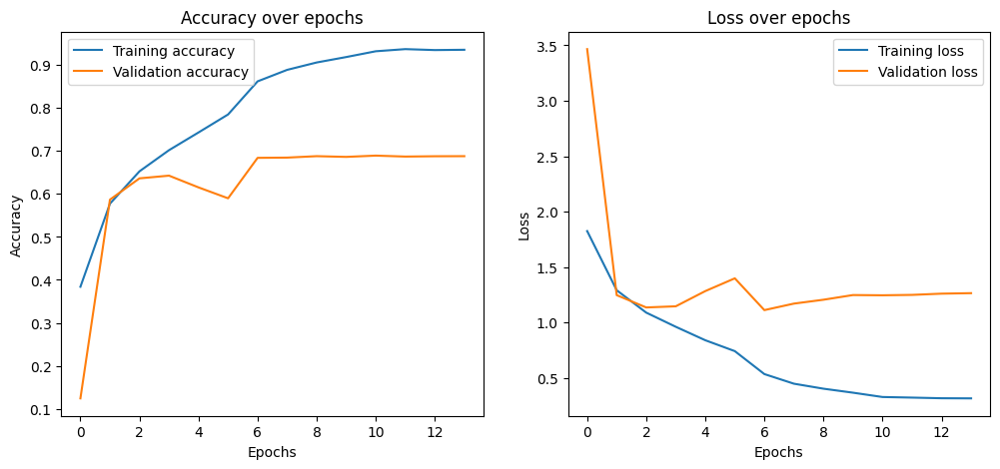

In [ ]:
## View model history for ResNet50 model

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(resnet_history.history['accuracy'], label='Training accuracy')
plt.plot(resnet_history.history['val_accuracy'], label='Validation accuracy')
plt.title('Accuracy over epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(resnet_history.history['loss'], label='Training loss')
plt.plot(resnet_history.history['val_loss'], label='Validation loss')
plt.title('Loss over epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

### CNN-10 Accuracy/Loss

The CNN-10 model took around 12 epochs to find an optimal decision surface and began to overfit around 7 epochs as the loss never improved beyond that.

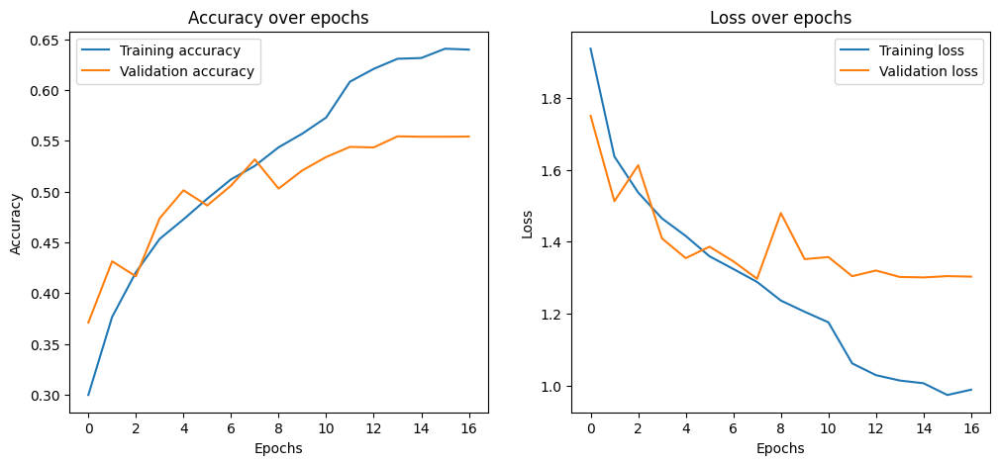

In [ ]:
## View model history for CNN-10 model

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(cnn10_history.history['accuracy'], label='Training accuracy')
plt.plot(cnn10_history.history['val_accuracy'], label='Validation accuracy')
plt.title('Accuracy over epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(cnn10_history.history['loss'], label='Training loss')
plt.plot(cnn10_history.history['val_loss'], label='Validation loss')
plt.title('Loss over epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

### ConvNet Accuracy/Loss

ConvNet had a more smooth training curve where the training loss and accuracy closely followed each other until the very end. Only after around 17 epochs did the validation accuracy and loss begin to not improve.

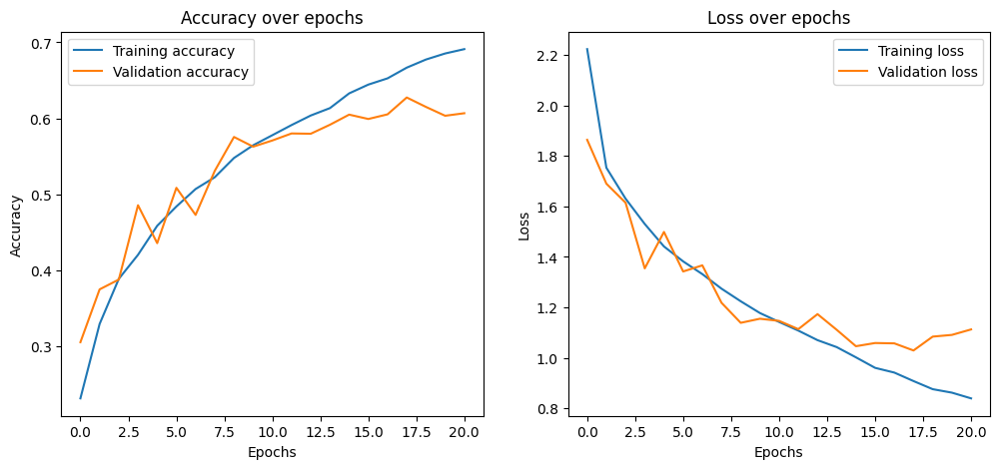

In [ ]:
## View model history for ConvNet

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(convnet_history.history['accuracy'], label='Training accuracy')
plt.plot(convnet_history.history['val_accuracy'], label='Validation accuracy')
plt.title('Accuracy over epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(convnet_history.history['loss'], label='Training loss')
plt.plot(convnet_history.history['val_loss'], label='Validation loss')
plt.title('Loss over epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()


## Viewing The Filters

One of the largest problems with certain machine learning algorithms like SVM's and CNN's is their resistance to interpretability. Lots of algorithms are very hard to understand, and the idea of a CNN building patterns is very unique in comparison with other models. Not that these patterns serve as answers to why a CNN made the decisions it did, but it provides interesting insights to how the images themselves are computed on.

This code segment will show 3 layers of our ConvNet and display each filter in a blue/red scale. Given an image we can view how apparent a filter or feature map is in the image (where red and white is how apparent it is and blue is the lack of). Each filter is a node in a given layer, and will be combined to make further patterns in the deeper layers.

It is important to note these are not the very last layers because the transfer based learning models we import have lots of convolutional passes that shrink the size of the image and pair together features to the point of unintelligibility (3 x 3), so we pull a couple of the regularly sized 12 x 12 layers.

Interestingly our model focuses lots on the eyes of the person in the image which is considered by the NIH to express more emotional information than the other facial parts for anger, fear, and sadness.

*NIH Research Paper:*

>Kim, M., Cho, Y., & Kim, S. Y. (2022). Effects of diagnostic regions on facial emotion recognition: The moving window technique. Frontiers in psychology, 13, 966623. https://doi.org/10.3389/fpsyg.2022.966623

### ConvNet Filters

The ConvNet filters focused heavily on the eyes of a person for feature extraction as opposed to edge or corner detection.

1/1 [==============================] - 0s 68ms/step


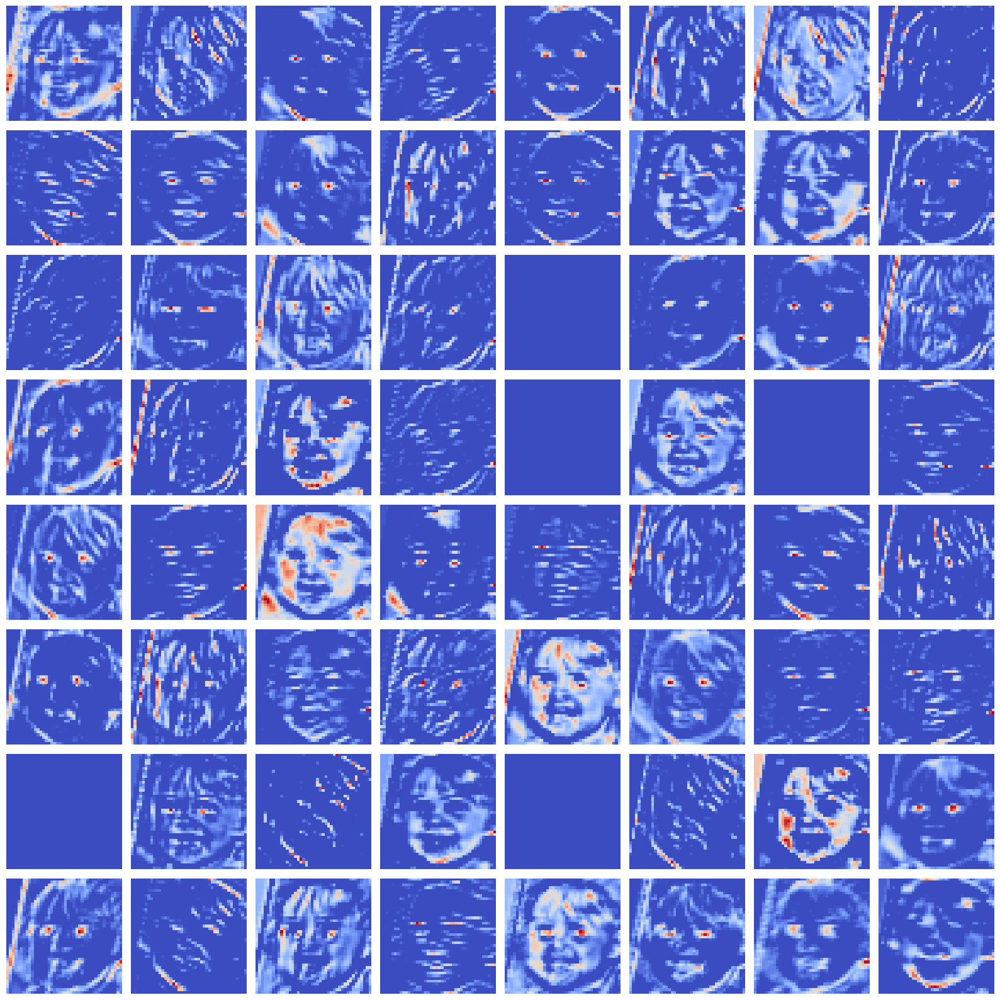

In [ ]:
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
import numpy as np

input_image = test_images[2]
input_image = np.expand_dims(input_image, axis=0)

# Create a new model that will output the feature maps
layer_name = 'conv2d_9'
intermediate_layer_model = Model(inputs=convnet_model.input,
                                 outputs=convnet_model.get_layer(layer_name).output)

# Get the feature maps
feature_maps = intermediate_layer_model.predict(input_image)

# Number of feature maps to visualize
num_feature_maps = feature_maps.shape[-1]

# Set up the subplot dimensions
subplot_x = int(np.ceil(np.sqrt(num_feature_maps)))
subplot_y = int(np.ceil(num_feature_maps / subplot_x))
plt.figure(figsize=(subplot_x * 2, subplot_y * 2))

# Plotting each feature map
for i in range(num_feature_maps):
    plt.subplot(subplot_y, subplot_x, i+1)
    plt.imshow(feature_maps[0, :, :, i], cmap='coolwarm')
    plt.axis('off')

plt.tight_layout()
plt.show()


### CNN-10 Filters

Because of the few convolutional layers in the CNN-10 model, it wasnt able to extract super complex features and we can see in the filters it focused heavily on simple edge detection among the faces.

1/1 [==============================] - 0s 92ms/step


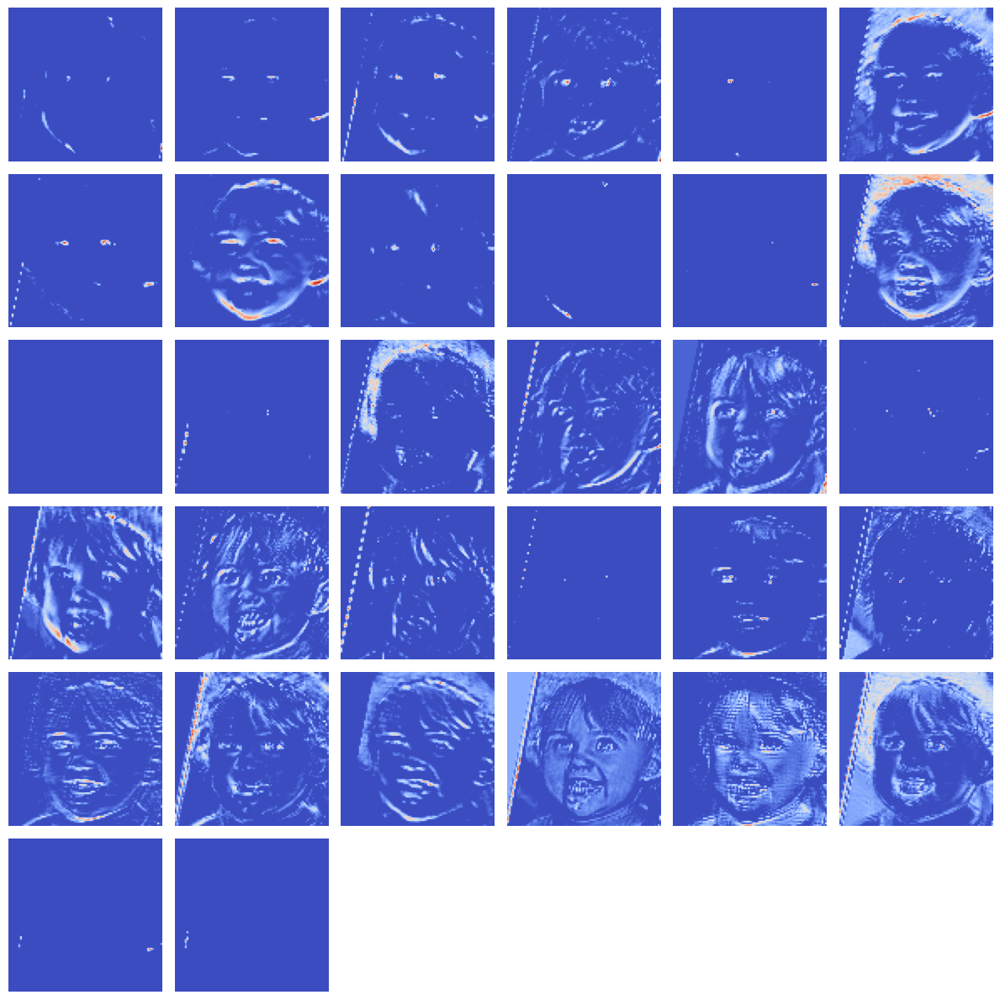

In [ ]:
input_image = test_images[2]
input_image = np.expand_dims(input_image, axis=0)

layer_name = 'conv2d_3'
intermediate_layer_model = Model(inputs=cnn10_model.input,
                                 outputs=cnn10_model.get_layer(layer_name).output)

# Get the feature maps
feature_maps = intermediate_layer_model.predict(input_image)

# Number of feature maps to visualize
num_feature_maps = feature_maps.shape[-1]

# Set up the subplot dimensionsCS370: Operating Systems
Dept. Of Computer Science, Colorado State University
L29.122
A comparison of the three models
Many-to-one One-to-One Many-to-Many
Kernel
Concurrency
During blocking
system call?
Kernel thread
creation
Caveat
NO YES if many
threads
YES
Process Blocks Process DOES NOT
block i
subplot_x = int(np.ceil(np.sqrt(num_feature_maps)))
subplot_y = int(np.ceil(num_feature_maps / subplot_x))
plt.figure(figsize=(subplot_x * 2, subplot_y * 2))

# Plotting each feature map
for i in range(num_feature_maps):
    plt.subplot(subplot_y, subplot_x, i+1)
    plt.imshow(feature_maps[0, :, :, i], cmap='coolwarm')
    plt.axis('off')

plt.tight_layout()
plt.show()

### ResNet50 Filters

The ResNet filters were more complex than the other models' filters and are seemingly uninterpretable compared to ConvNet and CNN-10. We chose to display the convolutional layer that was closest to the end but still semi-recognizable for some of the filters. The focus among these filters seems to be all over the place as the pooling layers have combined features from previous layers into something more abstract.

1/1 [==============================] - 0s 219ms/step


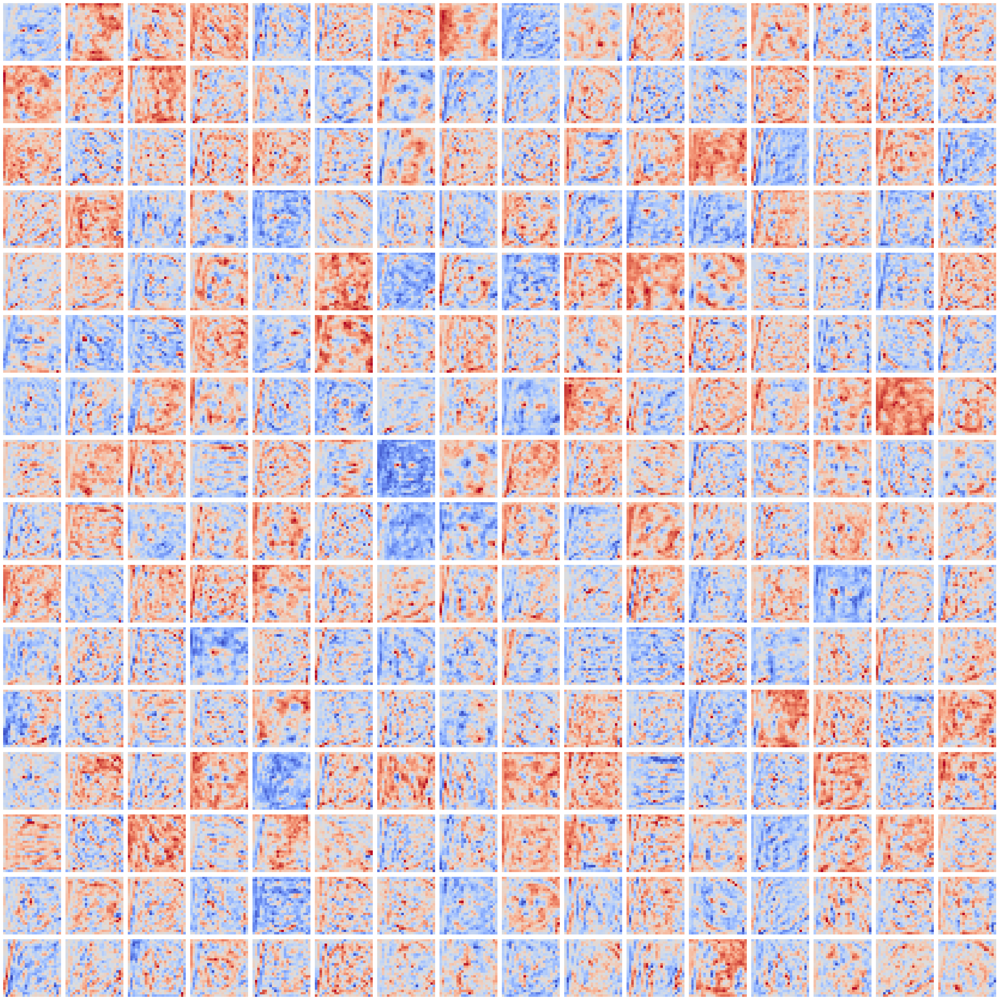

In [ ]:
# Get the ResNet block from your model
resnet_block = resnet_model.get_layer('resnet50')

layer_name = 'conv2_block3_3_conv'
target_layer = resnet_block.get_layer(layer_name)

# Create a new model that outputs the feature maps from the target_layer
intermediate_layer_model = Model(inputs=resnet_block.input, outputs=target_layer.output)

input_image = test_images[2]
input_image = np.expand_dims(input_image, axis=0)

# Get the feature maps
feature_maps = intermediate_layer_model.predict(input_image)

# Number of feature maps to visualize
num_feature_maps = feature_maps.shape[-1]

# Set up the subplot dimensions
subplot_x = int(np.ceil(np.sqrt(num_feature_maps)))
subplot_y = int(np.ceil(num_feature_maps / subplot_x))
plt.figure(figsize=(subplot_x * 2, subplot_y * 2))

# Plotting each feature map
for i in range(num_feature_maps):
    plt.subplot(subplot_y, subplot_x, i+1)
    plt.imshow(feature_maps[0, :, :, i], cmap='coolwarm')
    plt.axis('off')

plt.tight_layout()
plt.show()

## Incorrect Predictions of Our Models

Below are 10 examples from the test set that each model misclassified. You can see what the model predicted versus what the true label was.

An interesting note is that all 3 models seems to misclassify similar images, further proving the point that some of the labels of our dataset may not be the best representation of the images they are attached to.

### ResNet50 Misclassifications

87/87 [==============================] - 4s 31ms/step


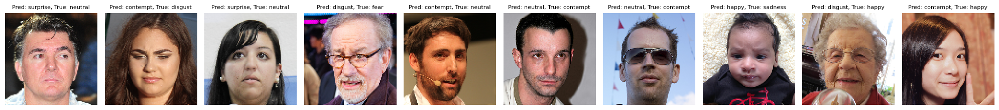

In [ ]:
# Make predictions
predictions = resnet_model.predict(test_images)
predicted_classes = np.argmax(predictions, axis=1)
true_classes = np.argmax(y_test_one_hot, axis=1)

# Find the indices of misclassified images
misclassified_indices = np.where(predicted_classes != true_classes)[0]

# Plot the misclassified images and labels
num_plot = min(len(misclassified_indices), 10)  # Set the number of images you want to display
plt.figure(figsize=(20, 4))

for i, incorrect in enumerate(misclassified_indices[:num_plot]):
    plt.subplot(1, num_plot, i + 1)
    plt.imshow(test_images[incorrect].squeeze(), cmap='gray', interpolation='none')
    plt.title(f"Pred: {class_names[predicted_classes[incorrect]]}, True: {class_names[true_classes[incorrect]]}", fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()

### CNN-10 Misclassifications

87/87 [==============================] - 0s 5ms/step


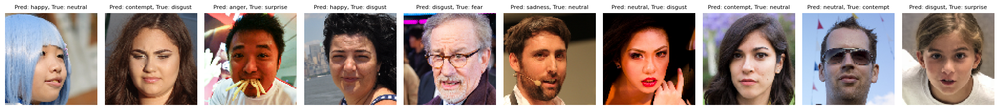

In [ ]:
# Make predictions
predictions = cnn10_model.predict(test_images)
predicted_classes = np.argmax(predictions, axis=1)
true_classes = np.argmax(y_test_one_hot, axis=1)

# Find the indices of misclassified images
misclassified_indices = np.where(predicted_classes != true_classes)[0]

# Plot the misclassified images and labels
num_plot = min(len(misclassified_indices), 10)  # Set the number of images you want to display
plt.figure(figsize=(20, 4))

for i, incorrect in enumerate(misclassified_indices[:num_plot]):
    plt.subplot(1, num_plot, i + 1)
    plt.imshow(test_images[incorrect].squeeze(), cmap='gray', interpolation='none')
    plt.title(f"Pred: {class_names[predicted_classes[incorrect]]}, True: {class_names[true_classes[incorrect]]}", fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()

### ConvNet Misclassifications

87/87 [==============================] - 1s 11ms/step


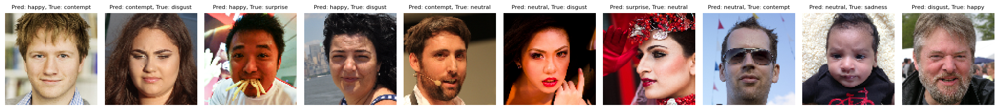

In [ ]:
# Make predictions
predictions = convnet_model.predict(test_images)
predicted_classes = np.argmax(predictions, axis=1)
true_classes = np.argmax(y_test_one_hot, axis=1)

# Find the indices of misclassified images
misclassified_indices = np.where(predicted_classes != true_classes)[0]

# Plot the misclassified images and labels
num_plot = min(len(misclassified_indices), 10)  # Set the number of images you want to display
plt.figure(figsize=(20, 4))

for i, incorrect in enumerate(misclassified_indices[:num_plot]):
    plt.subplot(1, num_plot, i + 1)
    plt.imshow(test_images[incorrect].squeeze(), cmap='gray', interpolation='none')
    plt.title(f"Pred: {class_names[predicted_classes[incorrect]]}, True: {class_names[true_classes[incorrect]]}", fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Convert To Binary Happy/Sad Classifier

As a piece of supplementary material to our research, we found ourselves very interested to see how one of the better performing models from our project would do with becoming a binary classifier for happiness verses sadness. We noticed throughout this project that the labels for our dataset may be a little off depending on the example and may be hurting accuracy. Each of our convolutional models, however, performed decent on classifying happiness and sadness. We believe this likely comes from the stark difference between a happy and sad face that we recognize in our daily lives.

So, could we get a better accuracy by throwing out classes of emotions that our classifiers did not perform well on and look at 2 emotions that we as humans can distinguish between quite well?

In [ ]:
# Filter out all examples except happy or sadness
mask_train = (y_train_balanced == 4) | (y_train_balanced == 6)
mask_test = (test_labels == 4) | (test_labels == 6)
mask_val = (validation_labels == 4) | (validation_labels == 6)

# Apply the mask to X and y to filter out the relevant examples
X_train_filtered = X_train_balanced[mask_train]
y_train_filtered = y_train_balanced[mask_train]
X_test_filtered = test_images[mask_test]
y_test_filtered = test_labels[mask_test]
X_val_filtered = validation_images[mask_val]
y_val_filtered = validation_labels[mask_val]

Our dataset has shrunk a lot, but is still large enough to give meaningful information to a neural network.

In [ ]:
print(X_train_filtered.shape)
print(X_test_filtered.shape)
print(X_val_filtered.shape)

(3983, 96, 96, 3)
(677, 96, 96, 3)
(1394, 96, 96, 3)


Make sure the data has been pruned correctly. Check that the examples are only happy or sad and the labels line up accordingly.

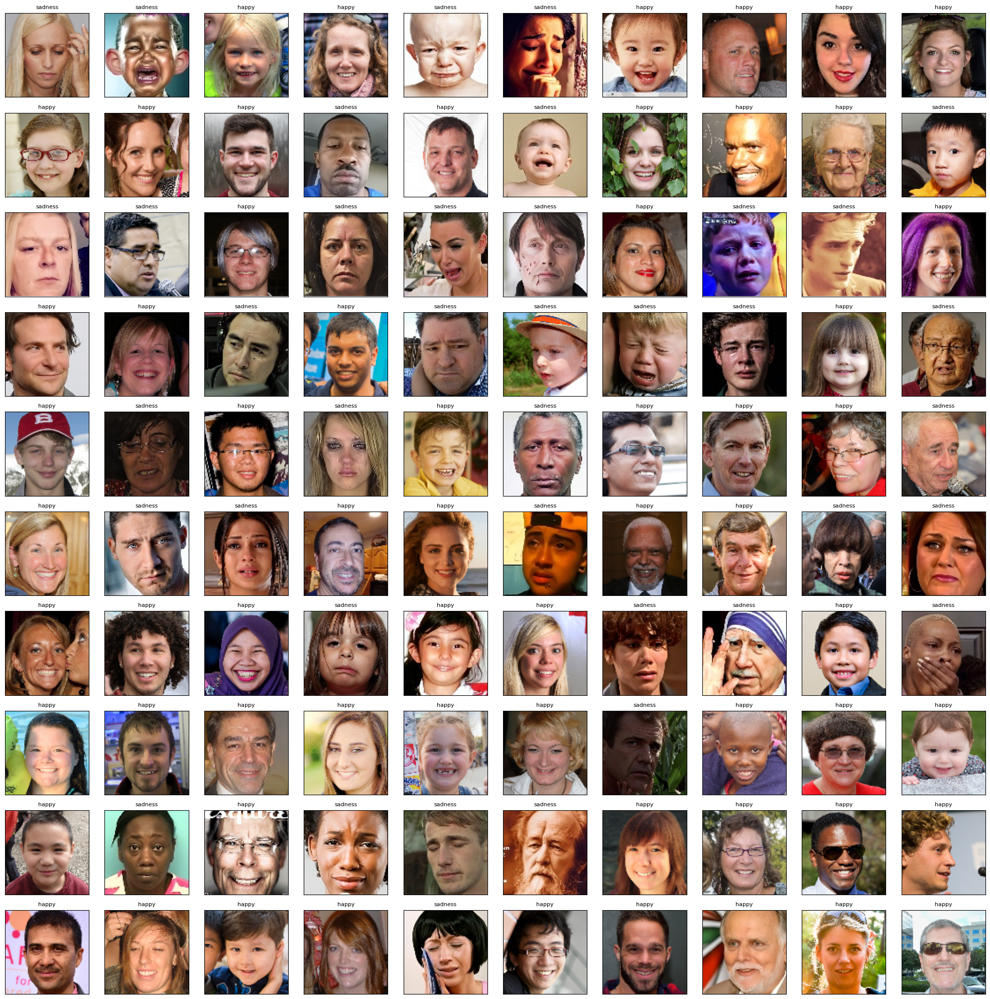

In [ ]:
plt.figure(figsize=(20, 20))  # width and height of figure
for i in range(100):  # take 100 images
    plt.subplot(10, 10, i + 1)  # plots 10x10
    plt.xticks([])  # Remove x-axis tick marks
    plt.yticks([])  # Remove y-axis tick marks
    plt.grid(False)
    plt.imshow(X_train_filtered[i], cmap=plt.cm.binary)  # Assume train_images are scaled between 0 and 1
    # Make sure class_names and train_labels are aligned and correct
    plt.title(class_names[y_train_filtered[i]], fontsize=8)
plt.tight_layout()  # Adjust subplots to fit into the figure area.
plt.show()

Because we are converting our model to a binary classifier, we need to change the labels from 4 and 6 to 0 and 1 respectively so that our new loss function and final activation function can perform correctly.

In [ ]:
# Change labels for the training set
y_train_filtered = np.where(y_train_filtered == 4, 0, 1)

# Change labels for the test set
y_test_filtered = np.where(y_test_filtered == 4, 0, 1)

# Change labels for the validation set
y_val_filtered = np.where(y_val_filtered == 4, 0, 1)

Create a data generator of our new pruned dataset with batch size still 32.

In [ ]:
batch_size = 32

X_train_balanced = X_train_filtered.astype('float32')
X_validation = X_val_filtered.astype('float32')

# Create a training generator with augmentation
data_generator = tf.keras.preprocessing.image.ImageDataGenerator(
    horizontal_flip=True,
    rotation_range=5,
    zoom_range=0.1,
    shear_range=0.1,
    fill_mode='nearest'
)

# Create a validation generator, without augmentation
validation_data_generator = tf.keras.preprocessing.image.ImageDataGenerator()
validation_generator = validation_data_generator.flow(X_validation, y_val_filtered, batch_size)

# Create training generator and the steps to take per epoch
train_generator = data_generator.flow(X_train_balanced, y_train_filtered, batch_size)
steps_per_epoch = X_train_balanced.shape[0] // batch_size

Make sure the generator is working correctly.

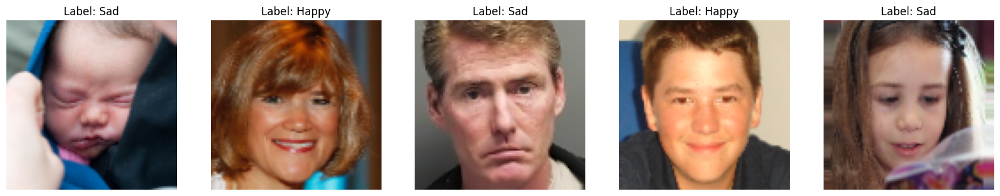

In [ ]:
# Get a batch of images and labels from the generator
label_names = {0: "Happy", 1: "Sad"}
augmented_images, augmented_labels = next(train_generator)

num_images_to_show = 5

fig, axes = plt.subplots(1, num_images_to_show, figsize=(20, 5))

# Iterate over the images and plot them
for i in range(num_images_to_show):
    image = augmented_images[i]
    label = augmented_labels[i]
    axes[i].imshow(image)
    axes[i].set_title(f"Label: {label_names[label]}")
    axes[i].axis('off')

plt.show()

We will use ConvNet to create our binary classifier. The main difference between the multiclassifier ConvNet and the Binary one is the last layer. We modify the final output neuron to only output 1 value between 0 and 1 with a sigmoid activation function. the weights of the model are also updated with a binary crossentropy loss function during gradient descent.

This results in a continuous value output by the network between 0 and 1 and can be interpreted as a confidence of being happy or sad. if the output is greater than 0.5, then we choose 1 (sad) as the output. If the output is less than 0.5, we choose 0 (happy) as the output.

In [ ]:
#1st convolution layer
convnet_model = Sequential()

convnet_model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', input_shape=(96, 96, 3)))
convnet_model.add(Conv2D(64,kernel_size= (3, 3), activation='relu'))
convnet_model.add(BatchNormalization())
convnet_model.add(MaxPooling2D(pool_size=(2,2), strides=(2, 2)))
convnet_model.add(Dropout(0.5))

#2nd convolution layer
convnet_model.add(Conv2D(64, (3, 3), activation='relu'))
convnet_model.add(Conv2D(64, (3, 3), activation='relu'))
convnet_model.add(BatchNormalization())
convnet_model.add(MaxPooling2D(pool_size=(2,2), strides=(2, 2)))
convnet_model.add(Dropout(0.5))

#3rd convolution layer
convnet_model.add(Conv2D(128, (3, 3), activation='relu'))
convnet_model.add(Conv2D(128, (3, 3), activation='relu'))
convnet_model.add(BatchNormalization())
convnet_model.add(MaxPooling2D(pool_size=(2,2), strides=(2, 2)))

convnet_model.add(Flatten())

#fully connected neural networks
convnet_model.add(Dense(1024, activation='relu'))
convnet_model.add(Dropout(0.2))
convnet_model.add(Dense(1024, activation='relu'))
convnet_model.add(Dropout(0.2))

convnet_model.add(Dense(1, activation='sigmoid'))

# convnet_model.summary()

#Compliling the convnet_model
convnet_model.compile(loss='binary_crossentropy',
              optimizer=Adam(),
              metrics=['accuracy'])

In [ ]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model_convnet_filtered.keras', monitor='val_accuracy', save_best_only=True)

convnet_filtered_history = convnet_model.fit(train_generator,
                    validation_data=validation_generator,
                    epochs=50,
                    callbacks=[early_stopping, model_checkpoint, ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3)]
                                    )

Epoch 1/50
125/125 [==============================] - 14s 85ms/step - loss: 0.8982 - accuracy: 0.7319 - val_loss: 1.8619 - val_accuracy: 0.6098 - lr: 0.0010
Epoch 2/50
125/125 [==============================] - 9s 69ms/step - loss: 0.3841 - accuracy: 0.8373 - val_loss: 0.3704 - val_accuracy: 0.8479 - lr: 0.0010
Epoch 3/50
125/125 [==============================] - 9s 70ms/step - loss: 0.3142 - accuracy: 0.8707 - val_loss: 0.3575 - val_accuracy: 0.8637 - lr: 0.0010
Epoch 4/50
125/125 [==============================] - 8s 66ms/step - loss: 0.2927 - accuracy: 0.8800 - val_loss: 0.5676 - val_accuracy: 0.8013 - lr: 0.0010
Epoch 5/50
125/125 [==============================] - 8s 66ms/step - loss: 0.2693 - accuracy: 0.8893 - val_loss: 0.3183 - val_accuracy: 0.8630 - lr: 0.0010
Epoch 6/50
125/125 [==============================] - 9s 69ms/step - loss: 0.2469 - accuracy: 0.9013 - val_loss: 0.2509 - val_accuracy: 0.8910 - lr: 0.0010
Epoch 7/50
125/125 [==============================] - 8s 66ms/s

In [ ]:
# Convert numpy floats to Python floats for JSON serialization
history_dict = {key: [float(val) for val in values] for key, values in convnet_filtered_history.history.items()}

# Dump into string
json_string = json.dumps(history_dict, indent=4)

# Define the file path
save_path = "/content/drive/My Drive/CS345 Project/convnet_filtered_history.json"

# Create directory if it does not exist
os.makedirs(os.path.dirname(save_path), exist_ok=True)

# Write to the JSON file
with open(save_path, 'w') as f:
    f.write(json_string)

print(f"History saved as JSON to '{save_path}'")

History saved as JSON to '/content/drive/My Drive/CS345 Project/convnet_filtered_history.json'


In [ ]:
# Load the convnet_history from a JSON file
load_path = "/content/drive/My Drive/CS345 Project/convnet_filtered_history.json"
with open(load_path, 'r') as f:
    history_dict = json.load(f)

# Create a simple class to mimic Keras' History object
class History:
    def __init__(self, history):
        self.history = history

# Load the history into the variable
convnet_filtered_history = History(history_dict)

print(f"History loaded from '{load_path}'")

History loaded from '/content/drive/My Drive/CS345 Project/convnet_filtered_history.json'


In [ ]:
# Save the final model
convnet_model.save('/content/drive/My Drive/CS345 Project/final_convnet_filtered_model.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [18]:
# Load the model if ever needed
convnet_model = keras.models.load_model('/content/drive/My Drive/CS345 Project/final_convnet_filtered_model.h5')

In [ ]:
convnet_eval = convnet_model.evaluate(X_test_filtered, y_test_filtered)
convnet_pred = convnet_model.predict(X_test_filtered)

22/22 [==============================] - 0s 10ms/step


Wow! this model is so much more accurate that our multiclassifier. We can see in the accuracy and loss per epoch graphs that the model converges quickly to a good solution and fine tunes its accuracy over the next few epochs to reach a great value of ~93% accurate.

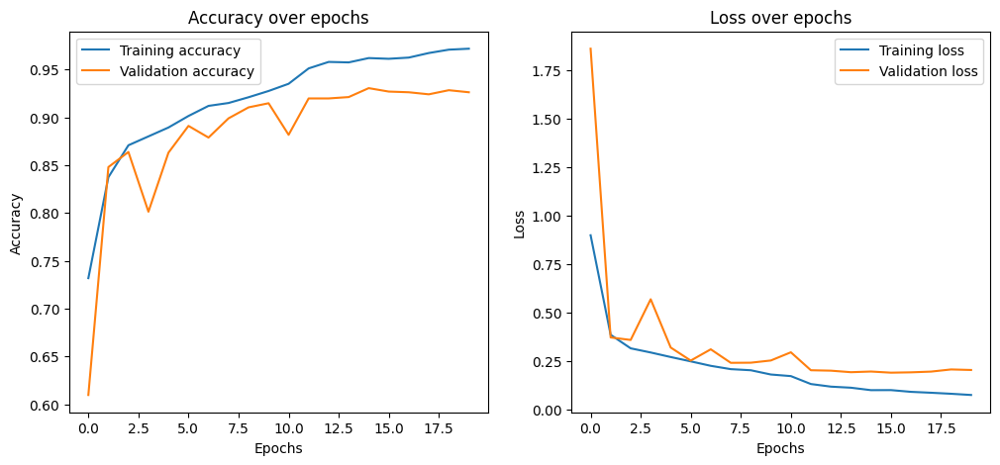

In [ ]:
## View model history for ConvNet

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(convnet_filtered_history.history['accuracy'], label='Training accuracy')
plt.plot(convnet_filtered_history.history['val_accuracy'], label='Validation accuracy')
plt.title('Accuracy over epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(convnet_filtered_history.history['loss'], label='Training loss')
plt.plot(convnet_filtered_history.history['val_loss'], label='Validation loss')
plt.title('Loss over epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()


The confusion matrix shows how successful our binary model was at finding a decision surface that explains our data well.

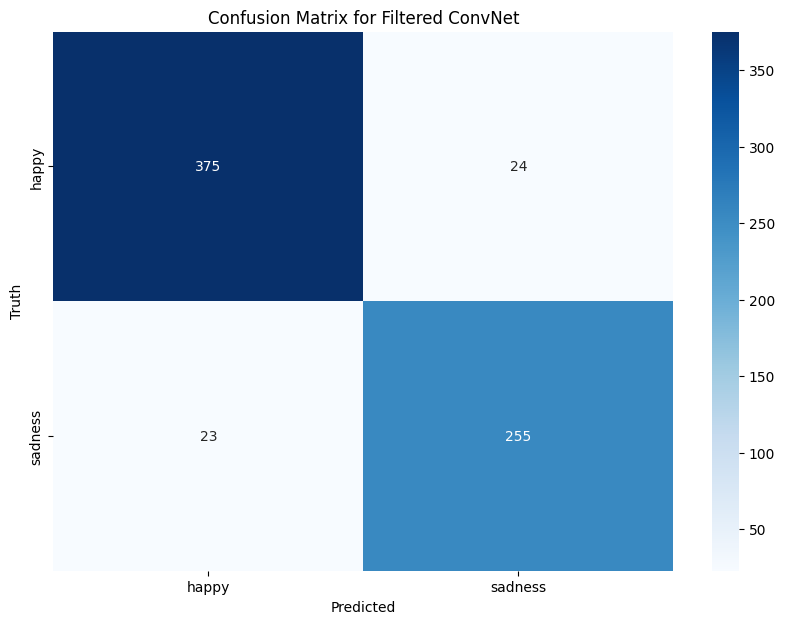

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sn

# Convert convnet_pred into 0 or 1
convnet_pred = np.where(convnet_pred > 0.5, 1, 0)

# Convert y_test_filtered into 0 or 1
convnet_filtered_pred_labels_names = [['happy', 'sadness'] for i in convnet_pred]

convnet_cm = confusion_matrix(y_test_filtered, convnet_pred)

plt.figure(figsize=(10,7))
sn.heatmap(convnet_cm, annot=True, fmt='d', cmap='Blues', xticklabels=['happy', 'sadness'], yticklabels=['happy', 'sadness'])
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Confusion Matrix for Filtered ConvNet')
plt.show()

Below are all the test images of happy or sad that our binary model misclassified.

Interestingly, if you look at them, you may agree more with the model than the true label. Also, some of these images seem to not be a great true example of being happy or sad, further expanding our analysis that our dataset has a bunch of unclearly labeled data.

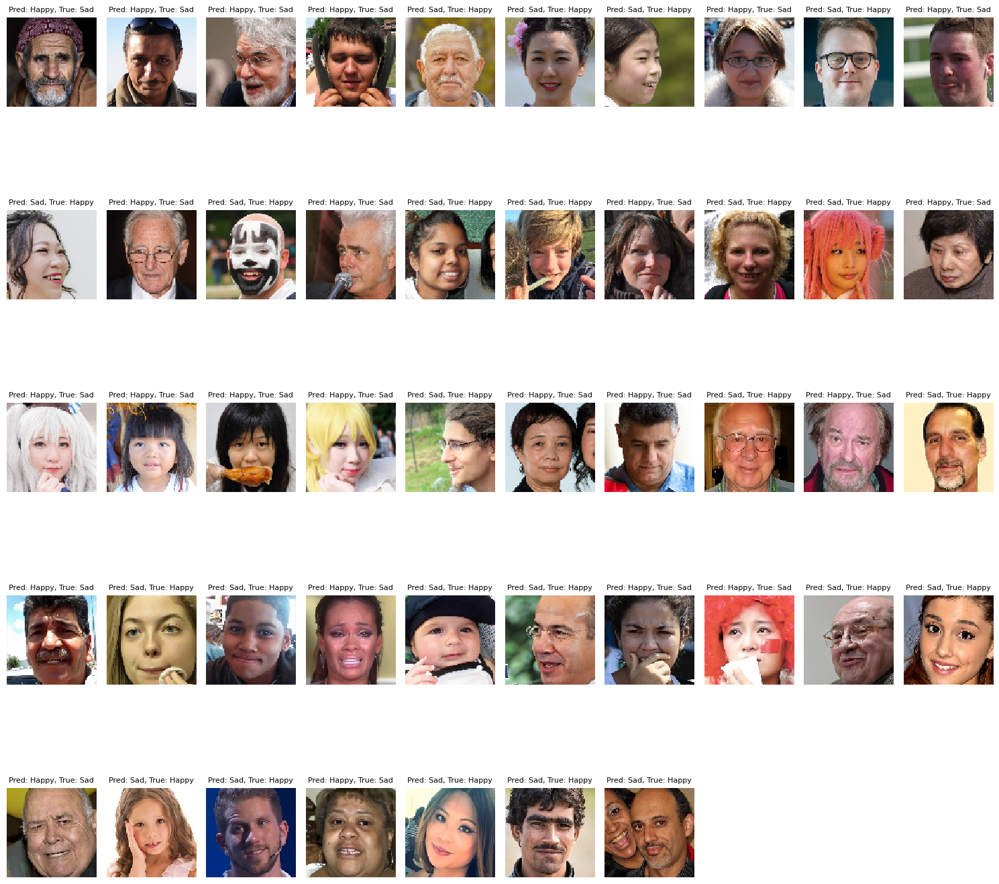

In [ ]:
# Define a mapping from numeric labels to string descriptions
label_names = {0: "Happy", 1: "Sad"}

# Convert convnet_pred into 0 or 1
predicted_classes = np.where(convnet_pred > 0.5, 1, 0)

# Flattening the predicted_classes if it's in 2D form ([n, 1] shape)
predicted_classes = predicted_classes.flatten()

# Get the true classes
true_classes = y_test_filtered

# Find the indices of misclassified images
misclassified_indices = np.where(predicted_classes != true_classes)[0]

# Plot the misclassified images and labels
num_images_to_show = 47 # Set the number of images you want to display

# Determine grid dimensions
num_cols = 10  # Number of columns
num_rows = (num_images_to_show + num_cols - 1) // num_cols  # Calculate rows needed

# Create a figure with subplots in a grid
plt.figure(figsize=(15, num_rows * 3))  # Adjust figure size as needed

for i, incorrect in enumerate(misclassified_indices[:num_images_to_show]):
    ax = plt.subplot(num_rows, num_cols, i + 1)
    ax.imshow(X_test_filtered[incorrect].squeeze(), cmap='gray', interpolation='none')
    pred_label_name = label_names[predicted_classes[incorrect]]
    true_label_name = label_names[true_classes[incorrect]]
    ax.set_title(f"Pred: {pred_label_name}, True: {true_label_name}", fontsize=8)  # Adjust font size as needed
    ax.axis('off')

plt.tight_layout()
plt.show()

## Test on Custom Images



We each took 96 x 96 photos of our faces making the expressions related to the ResNet50 transfer learned emotional labels and attempted to see how the model would predict our faces!

We begin by loading in the images from the shared Google drive and manually creating a one-hot-encoded array of true labels for the images.

In [4]:
custom_images = load_images_from_folder('/content/drive/My Drive/CS345 Project/Our_Photos')
custom_images = custom_images.astype('float32') / 255.0
print(custom_images.shape)

(16, 96, 96, 3)


In [5]:
class_names = ['anger', 'contempt', 'disgust', 'fear', 'happy', 'neutral', 'sadness', 'surprise']

In [12]:
custom_labels = np.array([0, 1, 2, 3, 4, 5, 6, 7, 5, 7, 0, 4, 5, 4, 5, 6])
custom_labels = to_categorical(custom_labels, num_classes=8)
print(custom_labels.shape)

(16, 8)


Just to make sure our label indices correspond correctly to the images, we plot out the images and the corresponding labels.

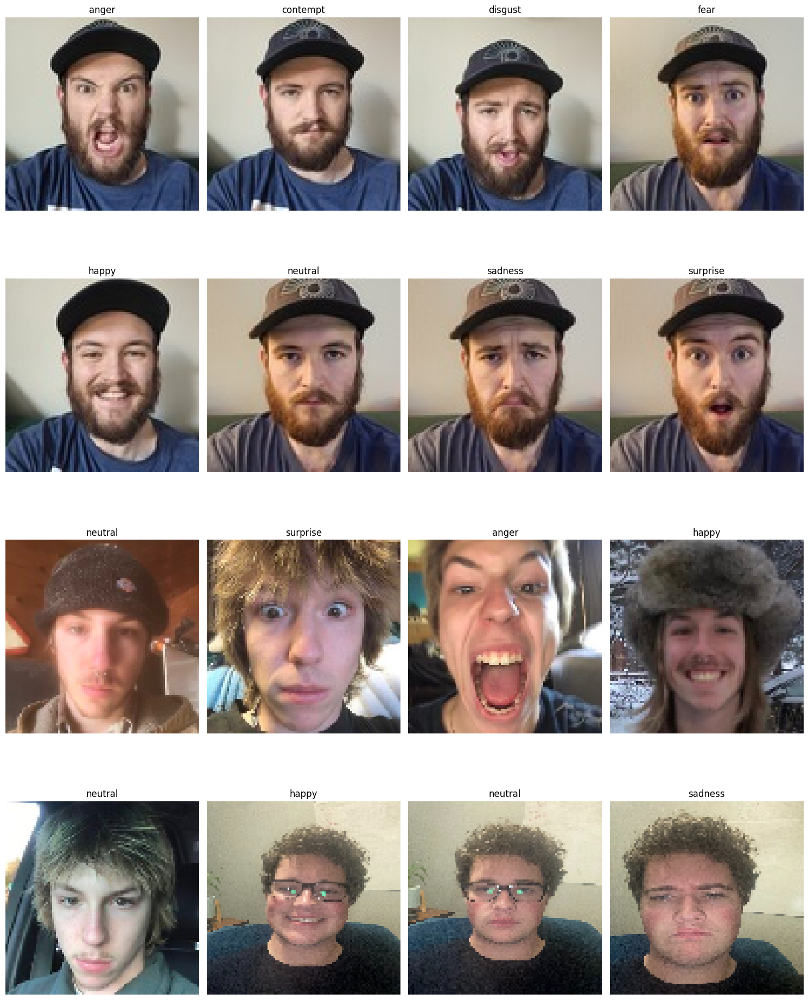

In [13]:
num_columns = 4
num_rows = (len(custom_images) + num_columns - 1) // num_columns

fig, axs = plt.subplots(num_rows, num_columns, figsize=(15, 5 * num_rows))

for i in range(num_rows * num_columns):
    ax = axs[i // num_columns, i % num_columns]
    if i < len(custom_images):
        ax.imshow(custom_images[i])
        ax.set_title(class_names[np.argmax(custom_labels[i])])
        ax.axis('off')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

Then we use the ResNet50 CNN to evaluate the accuracy and loss on our faces. The accuracy is comparable to the accuracy acheived on the test set of our original data. Let's take a closer look at which images the model got wrong.

In [15]:
resnet_model.evaluate(custom_images, custom_labels)

1/1 [==============================] - 4s 4s/step - loss: 1.6113 - accuracy: 0.5625


[1.6112735271453857, 0.5625]

As we expected, our model struggled with identifying contempt versus neutral expressions, sadness versus disgust expressions, and fear versus surprise expressions. Interestingly, it misclassifies Brendan's happy expression as sadness. We believe this is due to his beard or mustache obscuring the mouth feature filters used by our network.

1/1 [==============================] - 1s 948ms/step


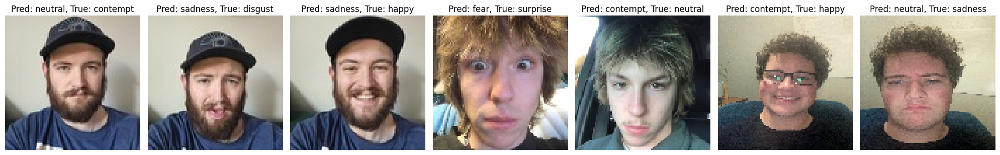

In [16]:
# Make predictions
predictions = resnet_model.predict(custom_images)
predicted_classes = np.argmax(predictions, axis=1)
true_classes = np.argmax(custom_labels, axis=1)

# Find the indices of misclassified images
misclassified_indices = np.where(predicted_classes != true_classes)[0]

# Plot the misclassified images and labels
num_plot = min(len(misclassified_indices), 10)  # Set the number of images you want to display
plt.figure(figsize=(20, 4))

for i, incorrect in enumerate(misclassified_indices[:num_plot]):
    plt.subplot(1, num_plot, i + 1)
    plt.imshow(custom_images[incorrect].squeeze(), cmap='gray', interpolation='none')
    plt.title(f"Pred: {class_names[predicted_classes[incorrect]]}, True: {class_names[true_classes[incorrect]]}", fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.show()

Lastly, just for fun, we pulled the happy and sadness labeled images from our custom photos and tested it against the binary CNN based on the ConvNet model.

In [17]:
binary_images = custom_images[[4, 6, 11, 13, 15]]

In [19]:
binary_labels = np.array([0, 1, 0, 0, 1])

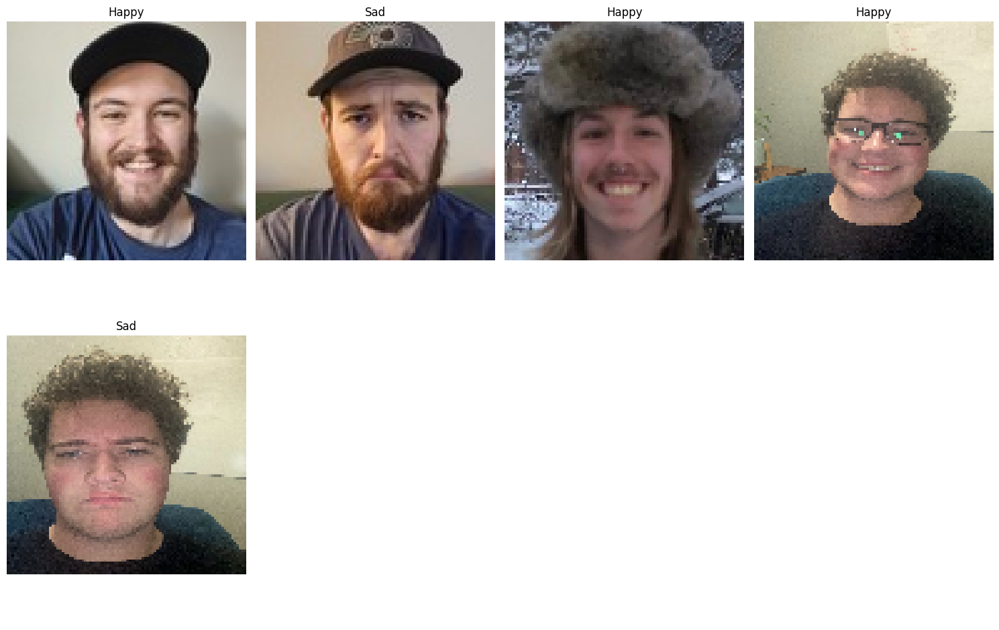

In [20]:
label_map = {0: "Happy", 1: "Sad"}
num_columns = 4
num_rows = 2

fig, axs = plt.subplots(num_rows, num_columns, figsize=(15, 5 * num_rows))

for i in range(num_rows * num_columns):
    ax = axs[i // num_columns, i % num_columns]
    if i < len(binary_images):
        ax.imshow(binary_images[i])
        ax.set_title(label_map[binary_labels[i]])
        ax.axis('off')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

The accuracy for testing across these images isnt too important as the test data is very small and misclassifying 1 example corresponds to a massive accuracy decrease.

In [21]:
convnet_model.evaluate(binary_images, binary_labels)

1/1 [==============================] - 1s 1s/step - loss: 1.0693 - accuracy: 0.6000


[1.0692706108093262, 0.6000000238418579]

In [22]:
convnet_pred = convnet_model.predict(binary_images)

1/1 [==============================] - 0s 128ms/step


We visualize the images the binary model misclassified and see that it is the same happy versus sadness image that the 8-class CNN misclassified as well!

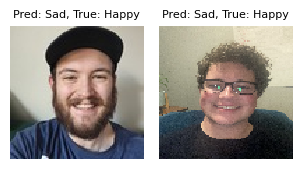

In [23]:
# Define a mapping from numeric labels to string descriptions
label_names = {0: "Happy", 1: "Sad"}

# Convert convnet_pred into 0 or 1
predicted_classes = np.where(convnet_pred > 0.5, 1, 0)

# Flattening the predicted_classes if it's in 2D form ([n, 1] shape)
predicted_classes = predicted_classes.flatten()

# Get the true classes
true_classes = binary_labels

# Find the indices of misclassified images
misclassified_indices = np.where(predicted_classes != true_classes)[0]

# Plot the misclassified images and labels
num_images_to_show = 47 # Set the number of images you want to display

# Determine grid dimensions
num_cols = 10  # Number of columns
num_rows = (num_images_to_show + num_cols - 1) // num_cols  # Calculate rows needed

# Create a figure with subplots in a grid
plt.figure(figsize=(15, num_rows * 3))  # Adjust figure size as needed

for i, incorrect in enumerate(misclassified_indices[:num_images_to_show]):
    ax = plt.subplot(num_rows, num_cols, i + 1)
    ax.imshow(binary_images[incorrect].squeeze(), cmap='gray', interpolation='none')
    pred_label_name = label_names[predicted_classes[incorrect]]
    true_label_name = label_names[true_classes[incorrect]]
    ax.set_title(f"Pred: {pred_label_name}, True: {true_label_name}", fontsize=8)  # Adjust font size as needed
    ax.axis('off')

plt.tight_layout()
plt.show()

# Conclusion

Throughout the past couple months of working on this project, we had a lot of fun and learned a lot about convolutional neural networks. One of the major challenges of this project was finding the best possible network architecture possible given our problem and dataset. Over 30 hours of research and testing various CNN model architectures was conducted to find the best 3 that performed well and had variation in their structure. We also learned more about the importance in machine learning of trying things out and seeing what works best. While you dont want to throw everything at the wall and see what sticks, testing out tons of achitectures, preprocessing techniques, and hyperparameter values through educated guesses is a large part of creating a sucessful model.

Overall the CNNs performed better than all versions of our baseline. Roughly our baselines were at 40% accuracy and the CNNs increased accuracy by about 20 or 30%. This isn't very surprising because of CNNs ability to extract such powerful patterns from images, however we were greatly surprised with the HOG SVM (more disucssed on that below). We attribute the stark difference between these two approaches to a CNNs ability to capture invariance in the data, as for SVMs operate on more concrete versions of features that are not flexible to rotations, shifts, and scaling.

## *Convolutional Neural Network Research*
Starting out, we had to research what different layers inside the keras library did and what purpose they served. Once we had a grasp on BatchNormalization, Dropout, MaxPooling, and Conv layers, we were able to start testing different CNN layouts and exploring what went wrong and what went right. We spent many hours tuning the hyperparameters for these layers and playing with convolutional filter sizes to find a balance between efficiency and accuracy.

Our custom models seemed to be plateauing around 65% accuracy however, and this was when Sarath mentioned to try transfer learning. After looking into various models in the keras.applications library we could use for transfer learning, we decided to test ResNet50, EfficientNetV2L, and MobileNetV2. All research we had conducted told us that freezing the base model and adding a custom input layer and fully connected dense output layer would provide the best results, but this was not the case. Only when we thawed the entire base ResNet50, EfficientNetV2L, or MobileNetV2 model and allowed their layers to be trainable did we see comparable accuracy to our custom models. We even tried to progressively thaw the base models by freezing all but the last few layers, then thaw the last half, then thaw all but the top few, but only when we thawed out the entire model and its top layers did it work for us.

This was very peculiar and while we are still slightly unsure why all the research pointed towards freezing the base model for best performance when it worked horribly for us. The conclusion we have come to is that the weights that the base models were trained on, "imagenet", is a dataset containing millions of images of different objects corresponding to 1000 different classes, and doesnt really fit our type of data well. We have only 1 type of object, a human face, with only 8 classes. The wide variety of features detected by the base models didnt correspond to our data well and we needed to retrain it from the ground up. This essentially defeated the purpose of traditional "transfer learning" but allowed us to use the complex architecture defined by ResNet for new purposes.

The idea of ResNet implementing residual blocks of convolutional layers seemed like a good idea to help with overfitting and mitigating a potential vanishing/exploding gradient problem by "reinjecting" the input signal (image data) through various sections of our network. This turned out to work well because the ResNet50 model we created had the best accuracy of any model!

We chose to leave out the implementations of EfficientNetV2L and MobileNetV2, not only for brevity, but because the accuracies for these models were extremely similar to the ResNet50 model and we wanted to explore other architectures in the project notebook.

After reading a few contemporary research papers outlining CNN architectures specifically designed for facial feature detection or emotional classification, We chose a few highly descriptive ones to include in the notebook: CNN-10 and ConvNet. Implementing these models helped us come to a further conclusion that our dataset maybe wasnt as perfectly labeled as we wouldve liked.

In the papers, these models were acheiving over 93-95% accuracy on popular human emotion image datasets like FER-2013, CK+, and AFFECTNET. However, we wanted to choose a lesser known dataset that didnt have any notebook examples trained on it on Kaggle. The discrepency between their accuracies and our accuracies using the exact same model shows that our dataset was not perfect for the architecture, was labeled incorrectly for some images, included hard to discern emotions (contempt, disgust), and might have been too small. Our dataset had images of size 96 x 96 pixels, but a lot of other popular datasets use 244 x 244 images. This could be why we needed to retrain the ResNet50 model from scratch as well, as imagenet contains 244 x 244 images and the features learned by ResNet would then not be applicable to a smaller image size. We also had no way of upscaling these images to 244 x 244 as it wouldnt have provided better pixel data to train the models on.

## *SVM Implementations*
After testing out a few CNN models and seeing our validation accuracy plateau around 65% every time, we knew we needed to try out a completely different classification technique to see if we were unfortunately on the wrong track. We knew that SVM's generally perform worse on image data than a CNN would because CNN's capture translational invariance among the features within an image that an SVM cannot. However, if a SVM model performed marginally worse on our data that our convolutional models, we would know that our models were performing at the peak accuracy possible given the limitations of the dataset. Luckily, all tricks we could think of to improve a baseline SVM accuracy all failed to produce an accuracy better than our worst convolutional model.

We can clearly see an increase in the SVM performance as more preprocessing is done on the data before the model begins training. Interestingly enough, both of the SVM preprocessing methods we used mimic the behavior of CNNs. What we mean by mimic is extracting features (or patterns). The first SVM we tried to improve from an original SVM was one that flat out uses ResNet, and the second was one that used its own form of feature extraction to capture the feature information of an image by quantifying the distribution of local intensity gradients or edge directions.

We want to spend a little time highlighting how powerful creating a SVM using HOG feature extraction is. To break down the steps of this model very simply, you convert the model to HOG features, search for hyperparameters, fit, and then predict classifications. This in total only took 30 minutes of runtime on Google CoLab pro. HOG feature extraction is so ridiculously fast because of its extreme dimensionality reduction done by its ability to turn roughly 30,000 features to merely 288. Keep in mind, this model was the highest performing SVM as well.

Unfortunately there were some SVM models that we could not fully implement for this notebook. A really interesting model that we wanted to implement was a facial landmarking model using the “dlib” library. This model provides unique methods for detecting eyes, noses, mouths, and comes with really unique visualizations of each feature. We were able to run this pre processing technique but encountered a unique issue when it failed to detect a face on select images. When the facial landmarks were not detected on an image computations would immediately fail upon classification. What should you do with the images that “don’t have faces” (but they really do)... A bad scientist would say to toss them, but that would only skew our results and would be practicing confirmation bias. It was for this reason we ended up not implementing this model, though we hope to use this technique in the future as we spent a significant amount of time learning about it.

